<a href="https://colab.research.google.com/github/purvi0116/Image-Generation-using-cGAN/blob/main/Conditional_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    one_hot = torch.nn.functional.one_hot(labels, n_classes)
    return one_hot
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined

In [7]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
# Initialization of model params
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.239815660715103, discriminator loss: 0.24827549758180975


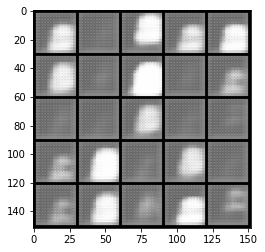

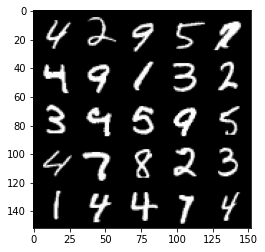

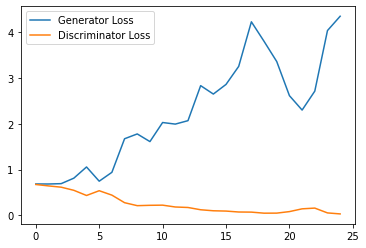

Step 1000: Generator loss: 4.329966915369034, discriminator loss: 0.06569487370364369


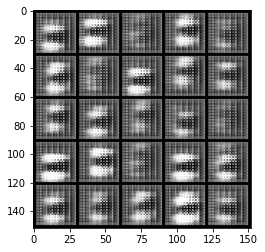

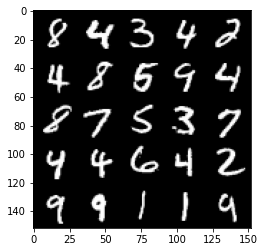

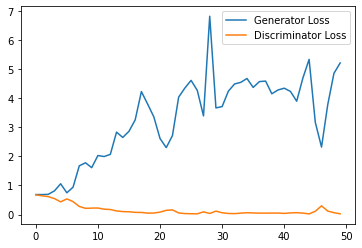

Step 1500: Generator loss: 4.7719944362640385, discriminator loss: 0.0468155177924782


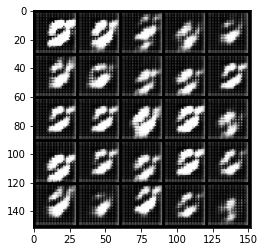

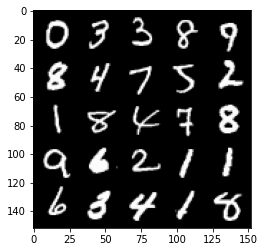

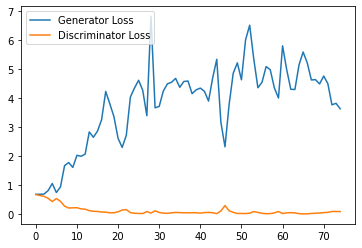

Step 2000: Generator loss: 3.8166010246276856, discriminator loss: 0.07431921218708158


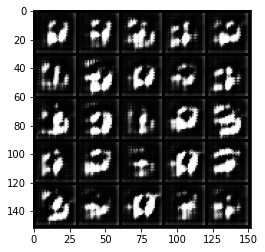

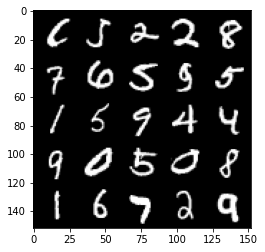

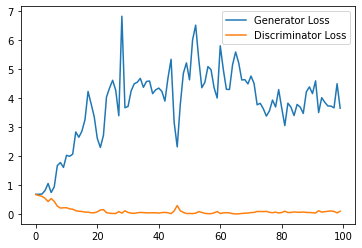

Step 2500: Generator loss: 3.314137697696686, discriminator loss: 0.13566642071306706


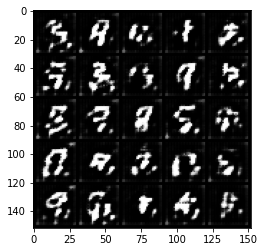

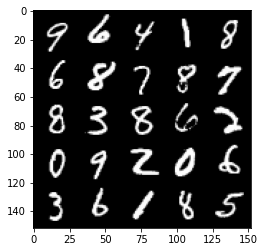

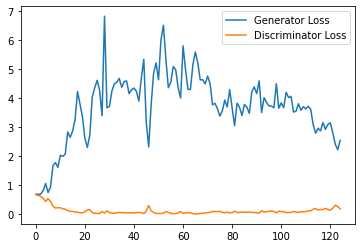

Step 3000: Generator loss: 2.4993866283893587, discriminator loss: 0.2993197271078825


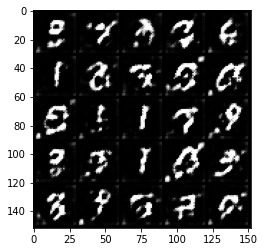

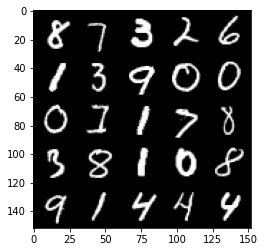

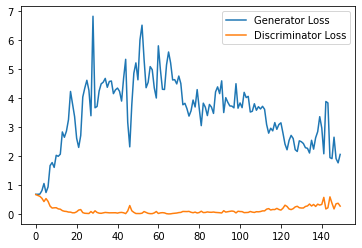

Step 3500: Generator loss: 2.2254724316596985, discriminator loss: 0.29945879194140435


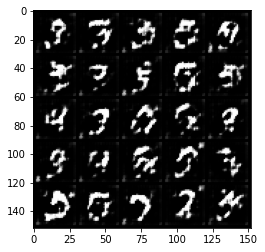

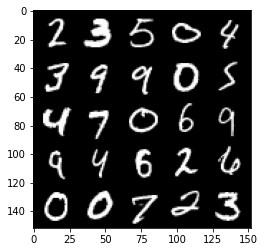

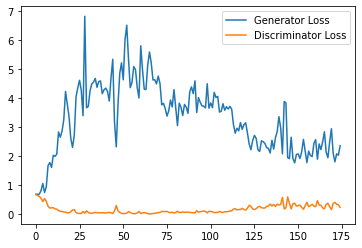

Step 4000: Generator loss: 2.171283056020737, discriminator loss: 0.30960484039783476


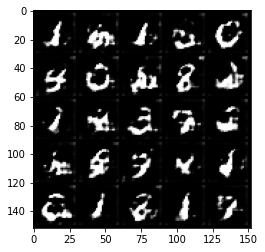

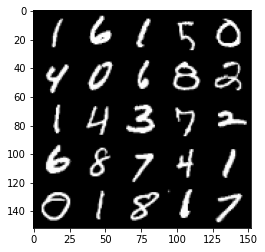

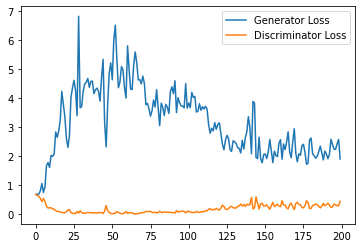

Step 4500: Generator loss: 2.07701935005188, discriminator loss: 0.3423059223294258


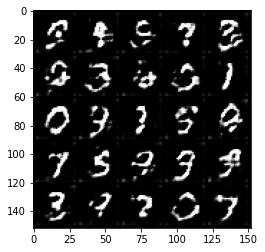

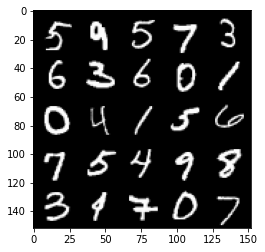

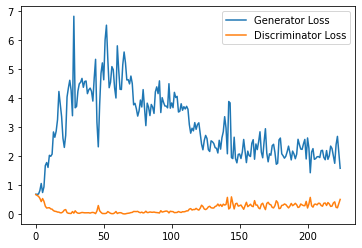

Step 5000: Generator loss: 2.031646703481674, discriminator loss: 0.33009961730241777


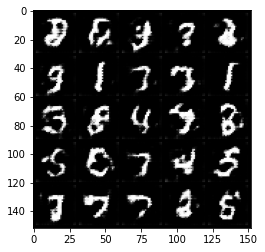

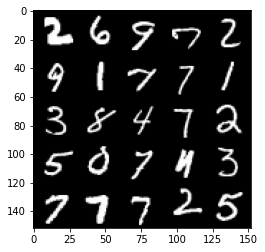

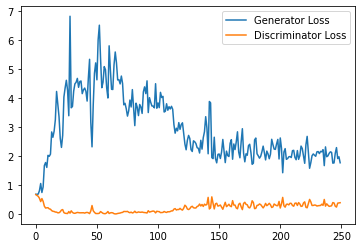

Step 5500: Generator loss: 2.0050019125938414, discriminator loss: 0.3288177876770496


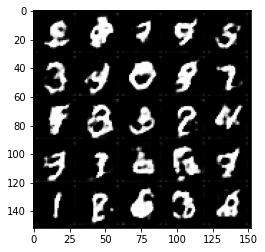

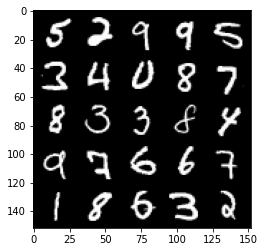

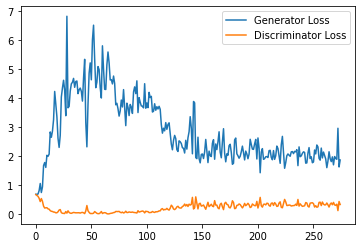

Step 6000: Generator loss: 1.870154800415039, discriminator loss: 0.34648593455553056


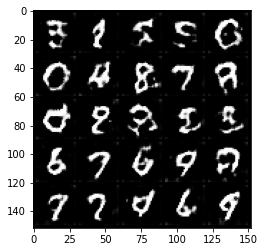

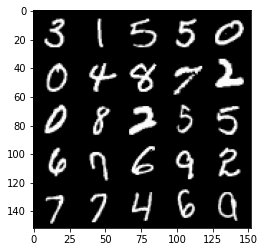

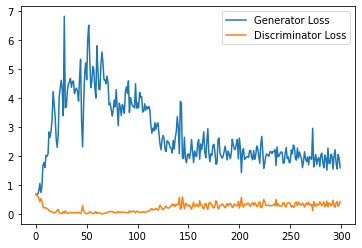

Step 6500: Generator loss: 1.869559217453003, discriminator loss: 0.36855964055657386


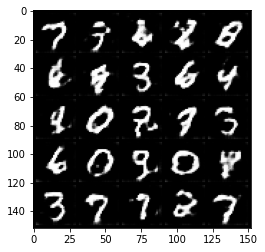

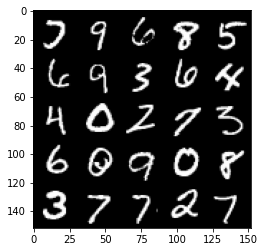

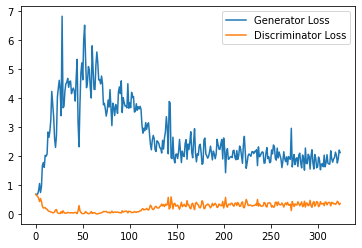

Step 7000: Generator loss: 1.6749006308317185, discriminator loss: 0.40502794659137725


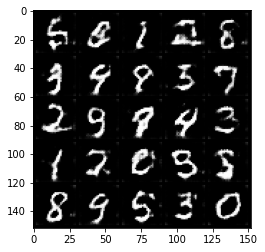

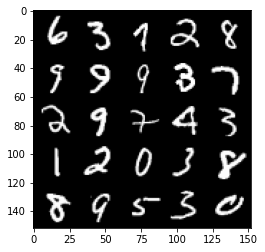

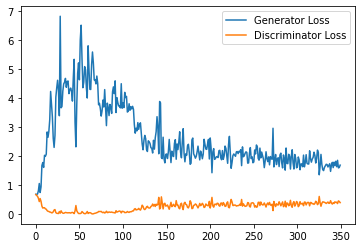

Step 7500: Generator loss: 1.7302715141773224, discriminator loss: 0.42110828799009326


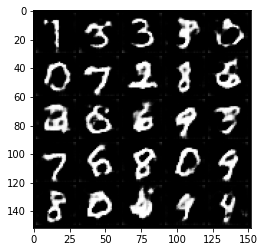

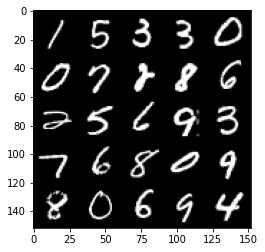

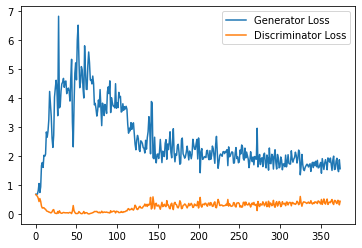

Step 8000: Generator loss: 1.5486579493284225, discriminator loss: 0.44142409902811053


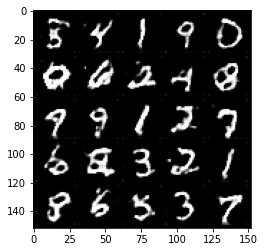

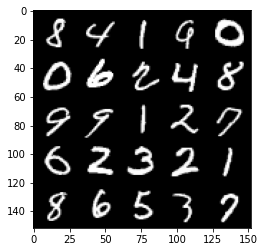

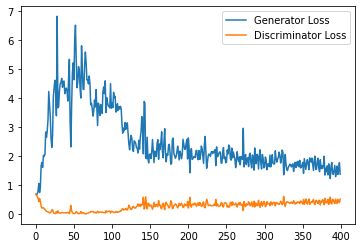

Step 8500: Generator loss: 1.5503687336444856, discriminator loss: 0.4611502783894539


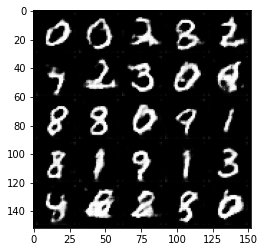

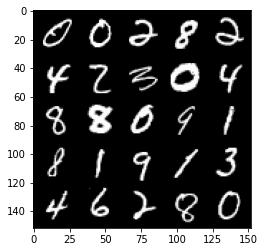

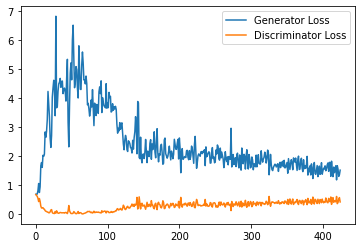

Step 9000: Generator loss: 1.4548539183139801, discriminator loss: 0.47622222805023195


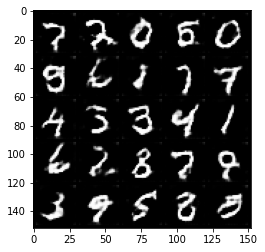

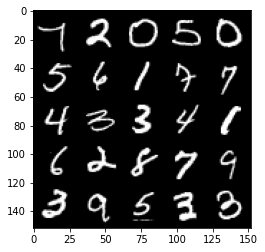

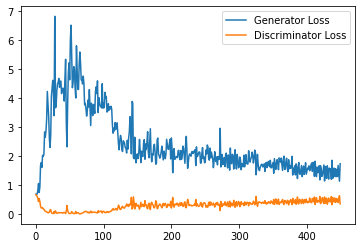

Step 9500: Generator loss: 1.4143681913614272, discriminator loss: 0.493901913523674


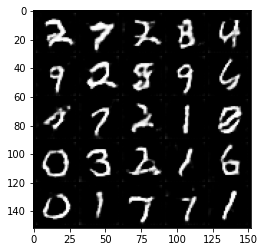

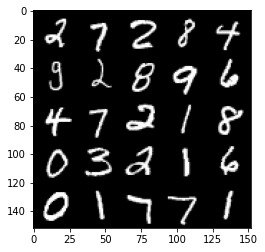

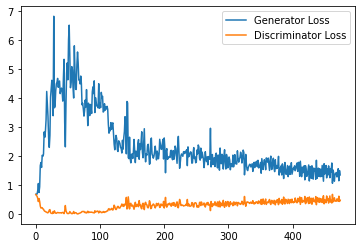

Step 10000: Generator loss: 1.4245998945236207, discriminator loss: 0.498656251013279


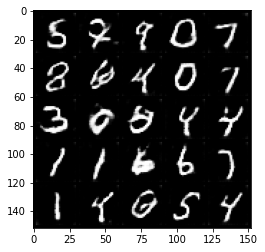

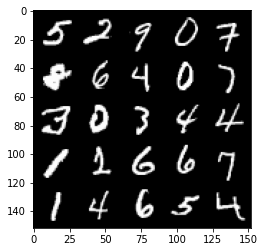

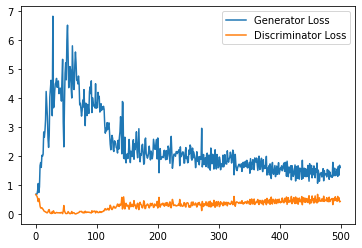

Step 10500: Generator loss: 1.3080452929735185, discriminator loss: 0.5108321216702462


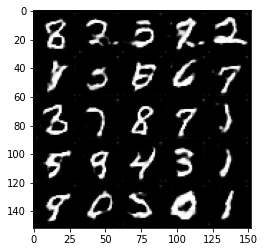

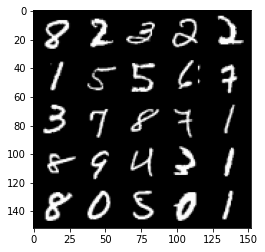

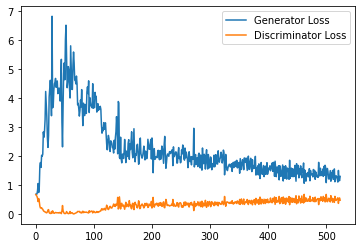

Step 11000: Generator loss: 1.3137969846725464, discriminator loss: 0.5152814949154854


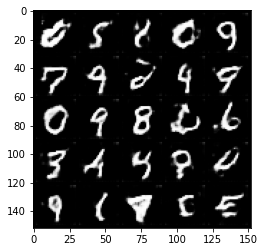

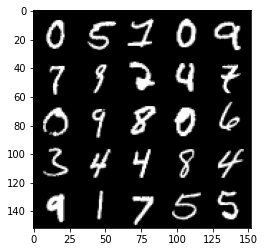

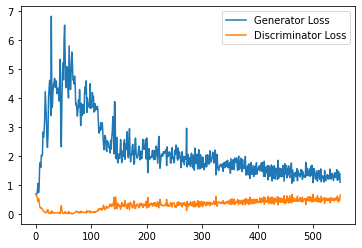

Step 11500: Generator loss: 1.2982107580900193, discriminator loss: 0.5086154320836067


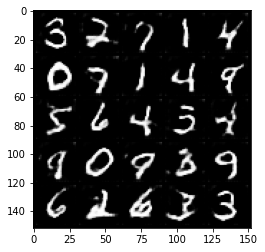

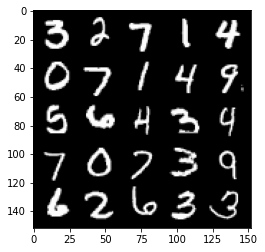

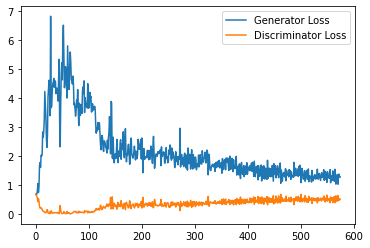

Step 12000: Generator loss: 1.2975897481441498, discriminator loss: 0.5273357688784599


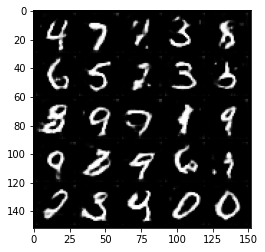

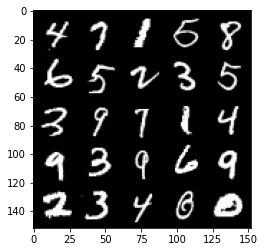

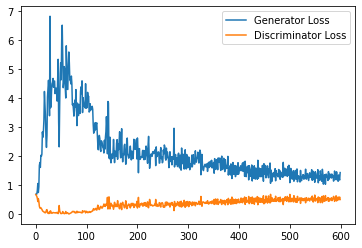

Step 12500: Generator loss: 1.236828352212906, discriminator loss: 0.5261971510052681


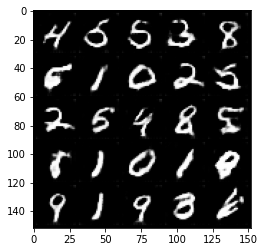

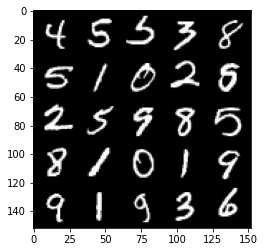

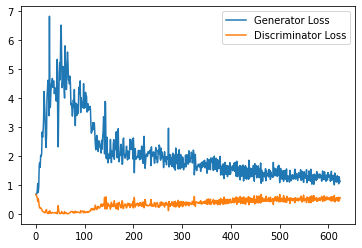

Step 13000: Generator loss: 1.242750697851181, discriminator loss: 0.5319222077727318


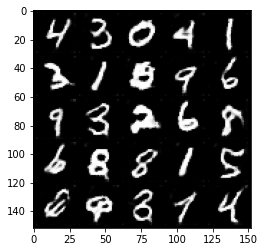

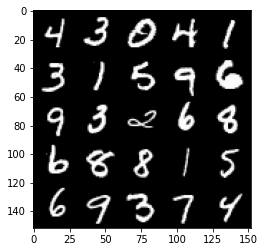

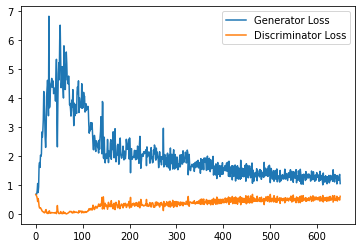

Step 13500: Generator loss: 1.2297412581443787, discriminator loss: 0.5349566035270691


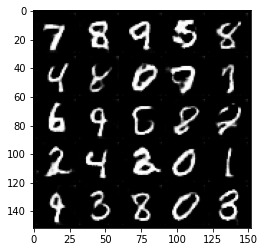

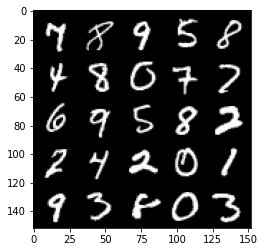

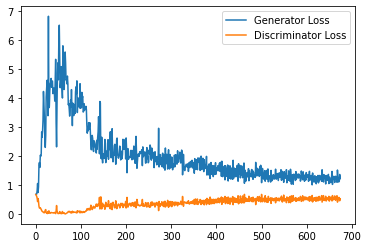

Step 14000: Generator loss: 1.2052702326774598, discriminator loss: 0.5429295026659966


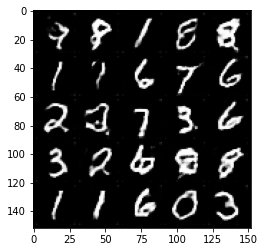

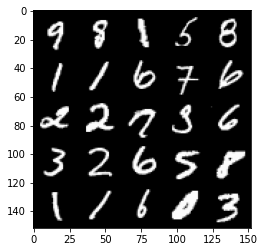

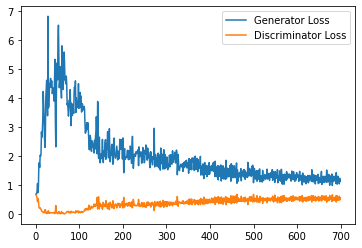

Step 14500: Generator loss: 1.164149474978447, discriminator loss: 0.5461794695854187


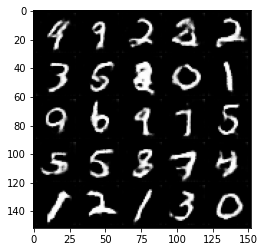

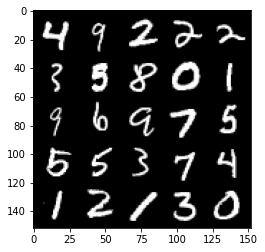

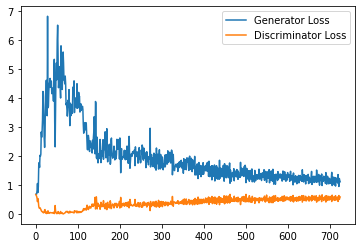

Step 15000: Generator loss: 1.1336142938137055, discriminator loss: 0.5565451997518539


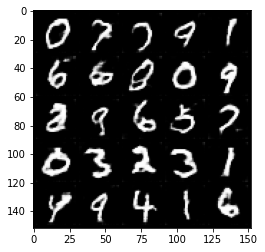

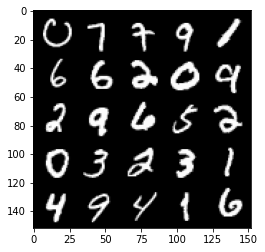

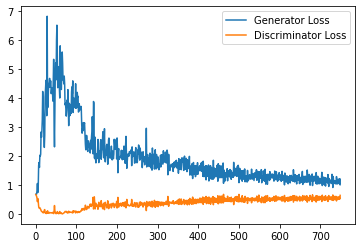

Step 15500: Generator loss: 1.17663542842865, discriminator loss: 0.5500486296415329


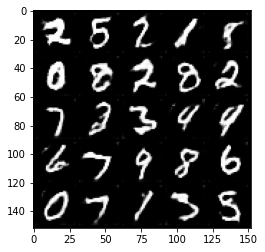

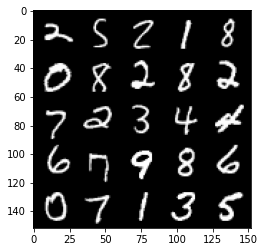

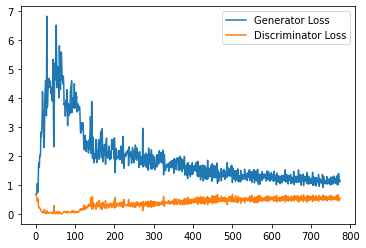

Step 16000: Generator loss: 1.1253430128097535, discriminator loss: 0.5643774905204773


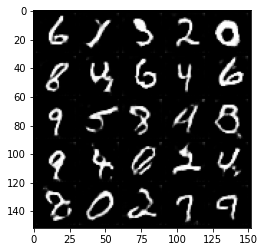

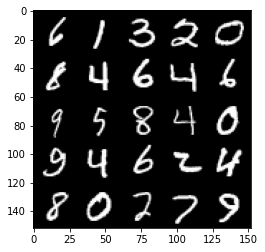

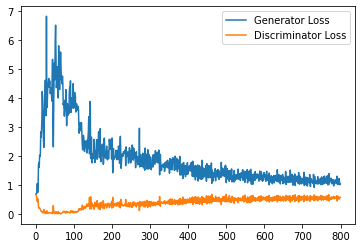

Step 16500: Generator loss: 1.0828135298490524, discriminator loss: 0.5651618327498436


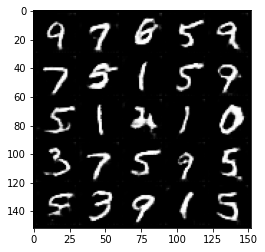

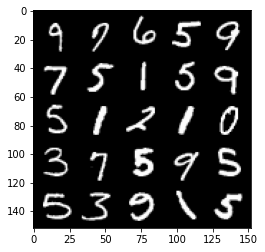

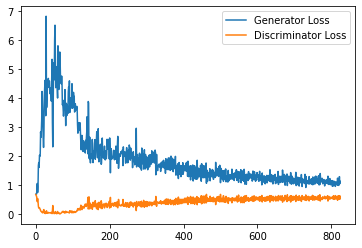

Step 17000: Generator loss: 1.1174215024709702, discriminator loss: 0.5672941662073135


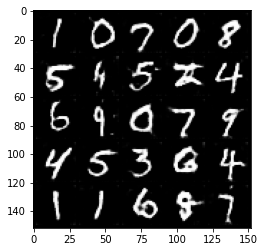

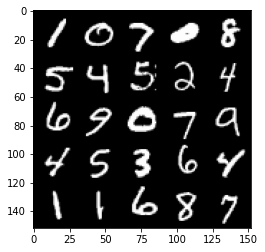

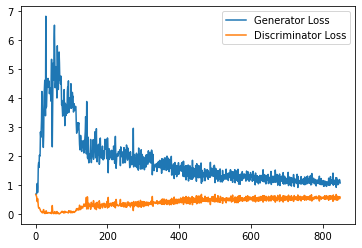

Step 17500: Generator loss: 1.100764478325844, discriminator loss: 0.5701087777614593


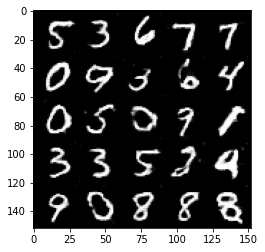

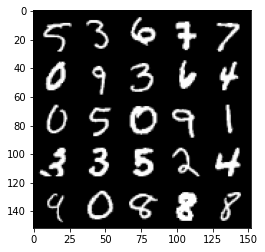

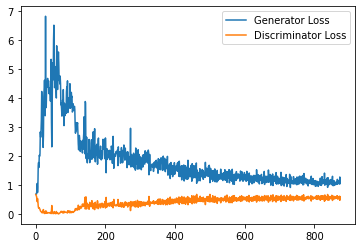

Step 18000: Generator loss: 1.1019952630996703, discriminator loss: 0.5730462499856949


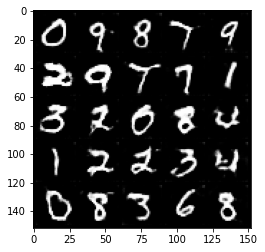

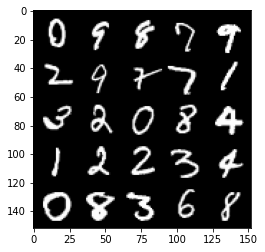

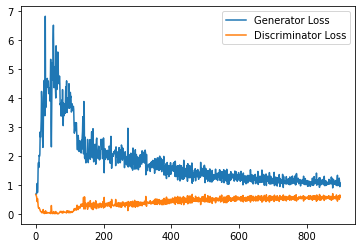

Step 18500: Generator loss: 1.1261506278514861, discriminator loss: 0.5705905750393867


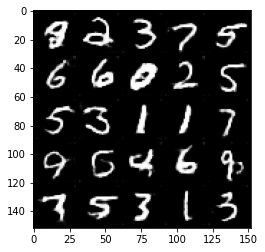

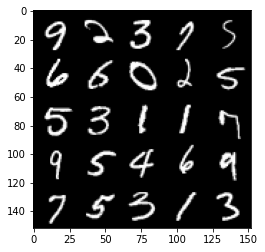

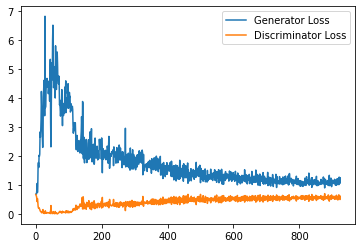

Step 19000: Generator loss: 1.1036240730285645, discriminator loss: 0.576231775522232


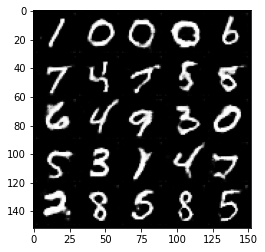

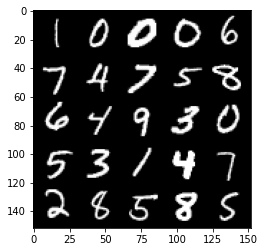

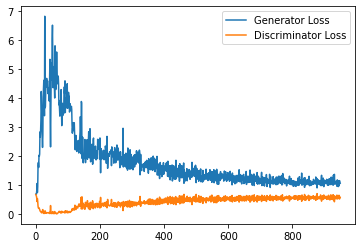

Step 19500: Generator loss: 1.0521171145439148, discriminator loss: 0.572537336409092


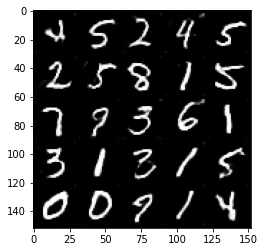

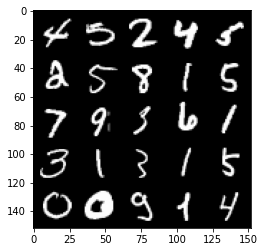

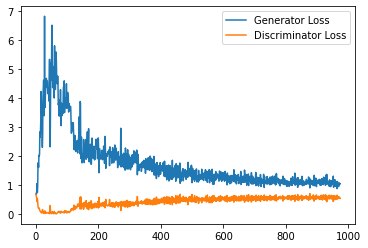

Step 20000: Generator loss: 1.0460943658351898, discriminator loss: 0.5736231627464294


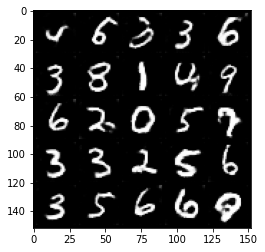

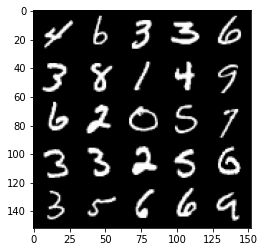

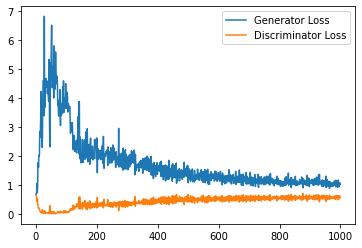

Step 20500: Generator loss: 1.056246124267578, discriminator loss: 0.5760593476295471


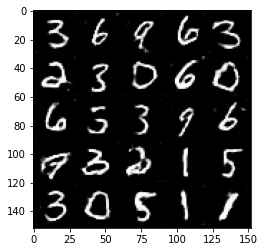

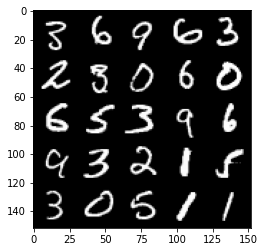

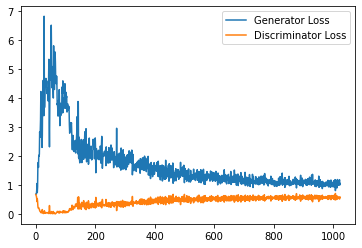

Step 21000: Generator loss: 1.059543928384781, discriminator loss: 0.5798144431114197


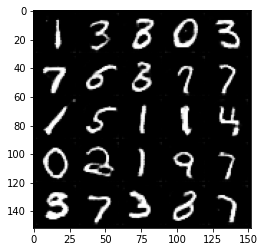

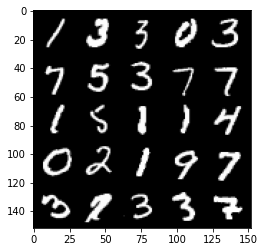

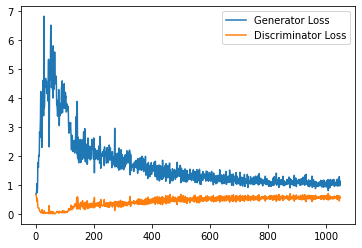

Step 21500: Generator loss: 1.0750377728939056, discriminator loss: 0.5846905452013016


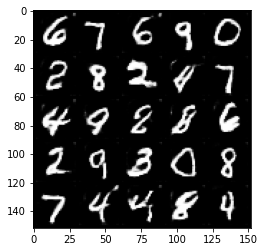

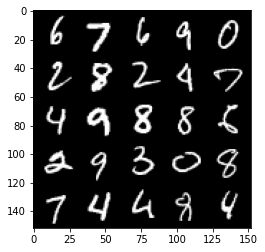

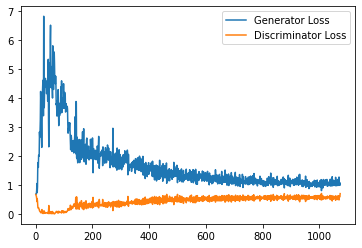

Step 22000: Generator loss: 1.0611708208322526, discriminator loss: 0.5800495400428772


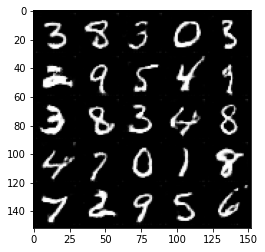

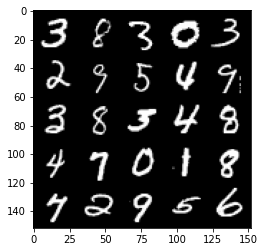

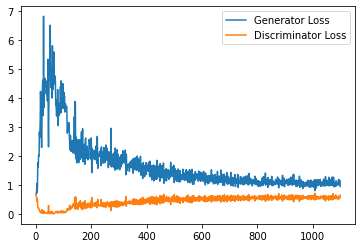

Step 22500: Generator loss: 1.0736717077493667, discriminator loss: 0.5779753403663636


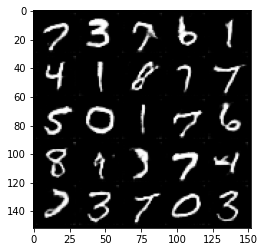

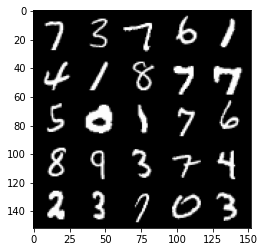

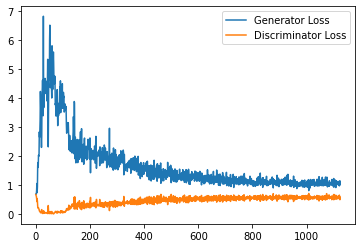

Step 23000: Generator loss: 1.0272502815723419, discriminator loss: 0.5860817502737046


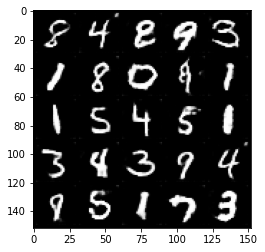

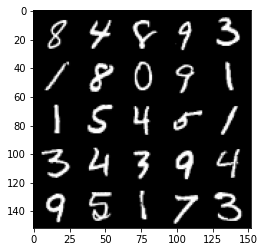

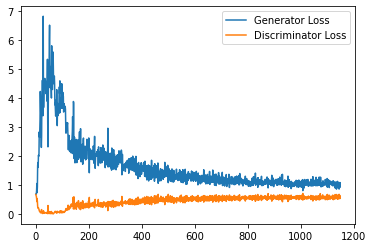

Step 23500: Generator loss: 1.056222179532051, discriminator loss: 0.5820277964472771


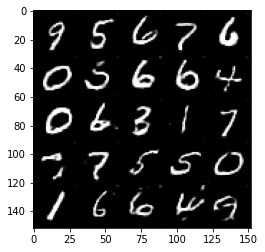

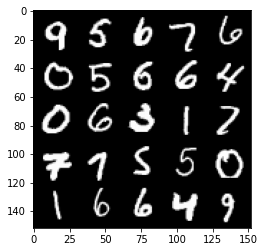

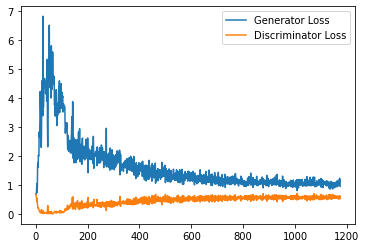

Step 24000: Generator loss: 1.0638057827949523, discriminator loss: 0.5808990304470062


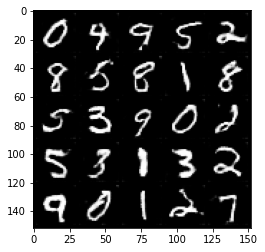

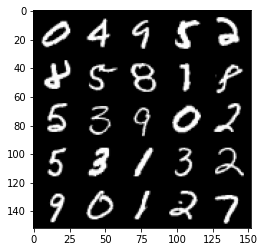

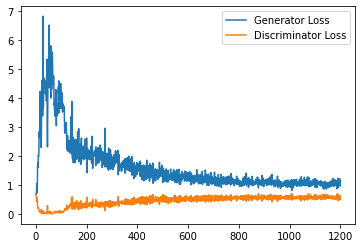

Step 24500: Generator loss: 1.0713038012981415, discriminator loss: 0.5803846840262413


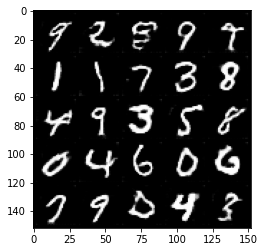

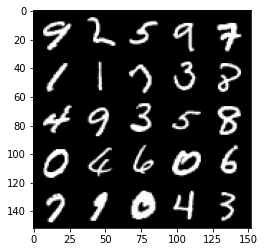

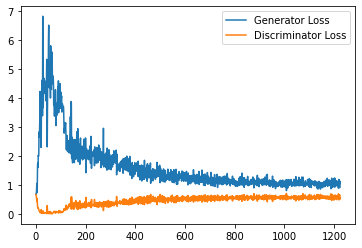

Step 25000: Generator loss: 1.0347358196973802, discriminator loss: 0.5793080219626426


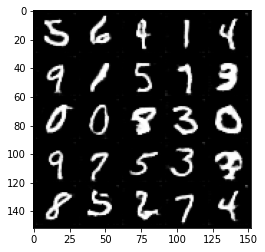

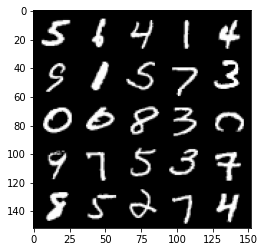

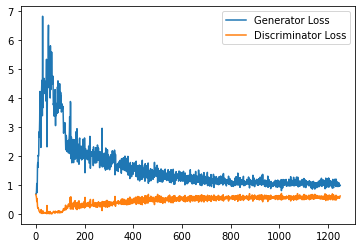

Step 25500: Generator loss: 1.0486979796886444, discriminator loss: 0.58066140884161


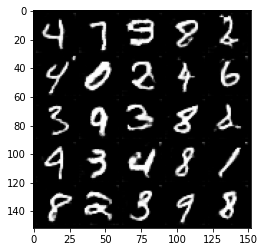

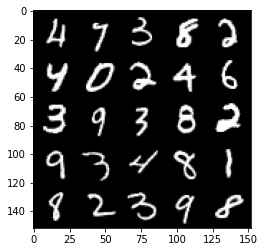

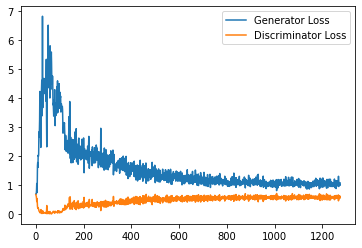

Step 26000: Generator loss: 1.072310247182846, discriminator loss: 0.5793468101024628


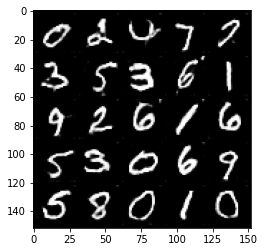

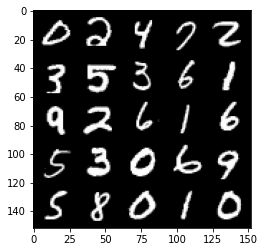

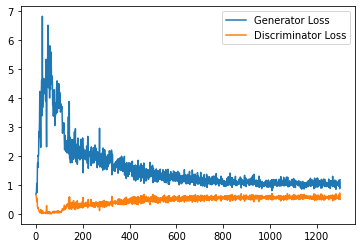

Step 26500: Generator loss: 1.0571718348264694, discriminator loss: 0.5884886897206306


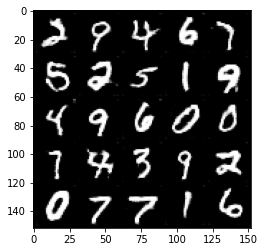

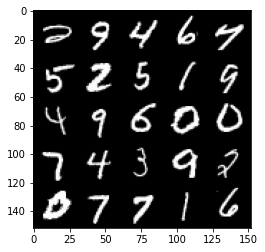

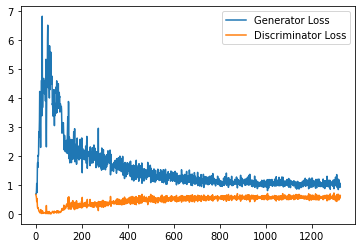

Step 27000: Generator loss: 1.068930715918541, discriminator loss: 0.5798725818991661


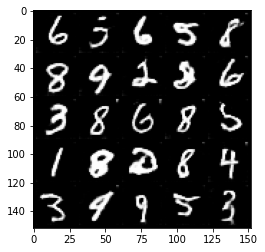

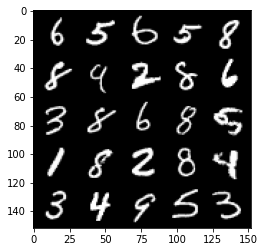

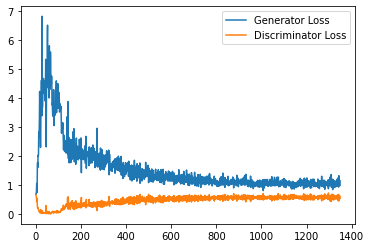

Step 27500: Generator loss: 1.0546352655887603, discriminator loss: 0.5841283273100853


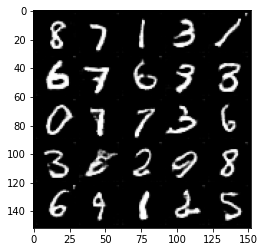

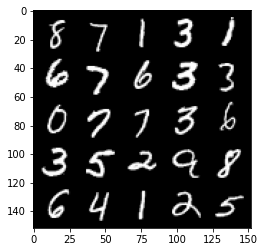

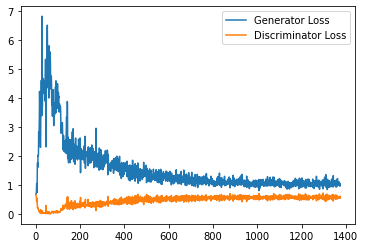

Step 28000: Generator loss: 1.072553443312645, discriminator loss: 0.5800552355051041


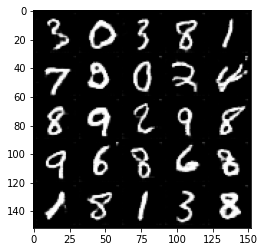

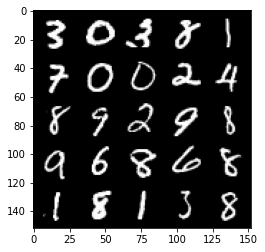

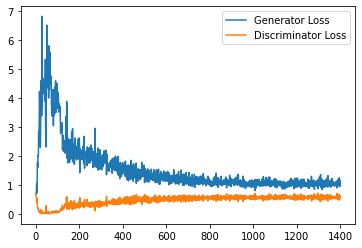

Step 28500: Generator loss: 1.0591623502969743, discriminator loss: 0.5878222227692604


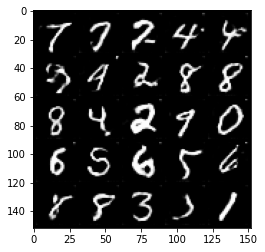

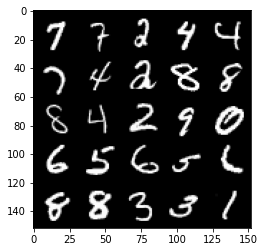

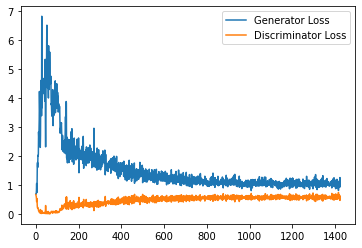

Step 29000: Generator loss: 1.027546868801117, discriminator loss: 0.584470938205719


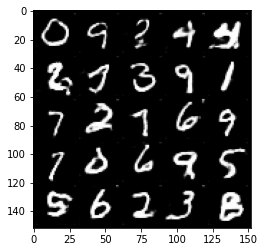

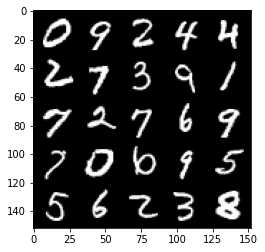

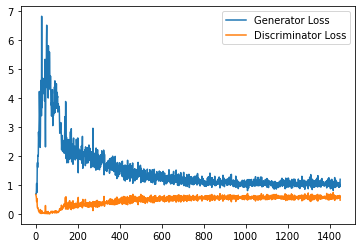

Step 29500: Generator loss: 1.0467158495187758, discriminator loss: 0.5869695660471916


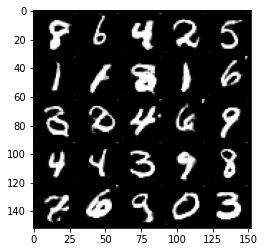

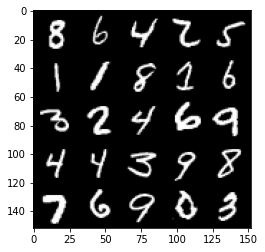

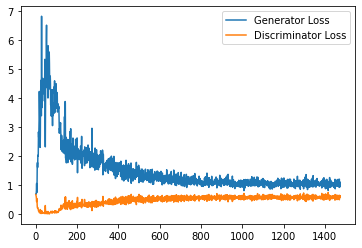

Step 30000: Generator loss: 1.0649236240386963, discriminator loss: 0.5843272434473038


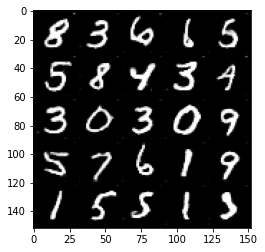

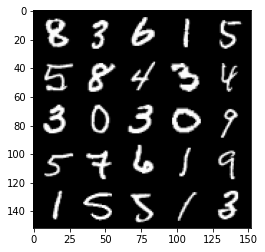

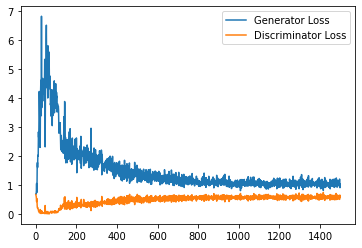

Step 30500: Generator loss: 1.0520586117506028, discriminator loss: 0.5851868025064468


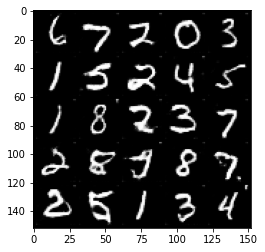

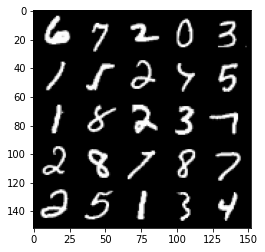

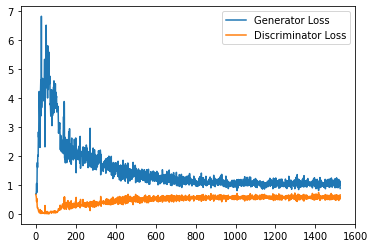

Step 31000: Generator loss: 1.0419381366968155, discriminator loss: 0.5790213388800621


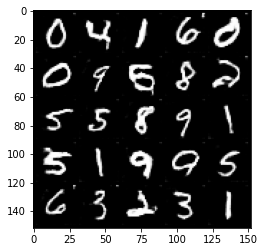

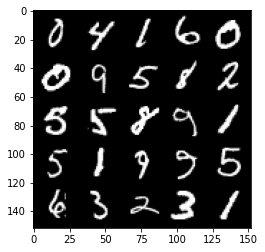

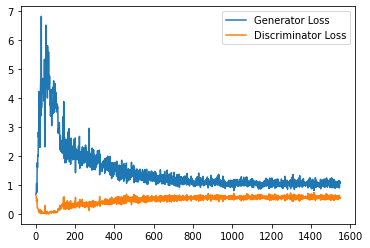

Step 31500: Generator loss: 1.028937495827675, discriminator loss: 0.5843556762337685


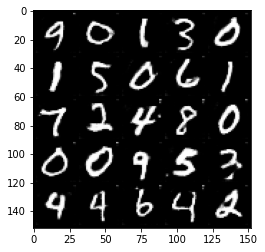

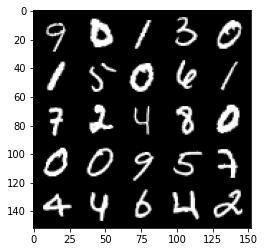

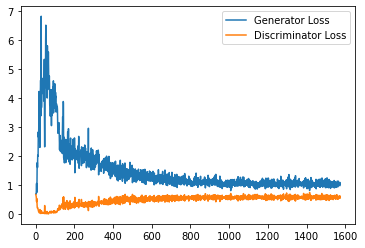

Step 32000: Generator loss: 1.0721437842845918, discriminator loss: 0.5821744220256806


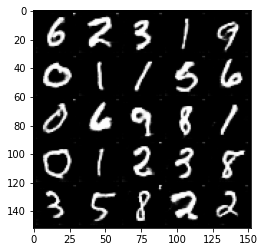

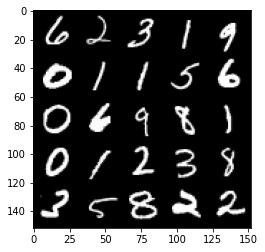

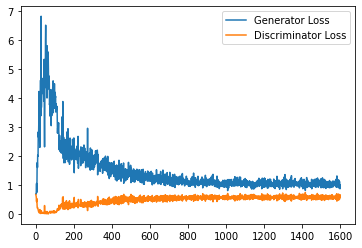

Step 32500: Generator loss: 1.0493242852687836, discriminator loss: 0.5832937615513801


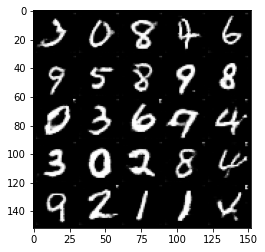

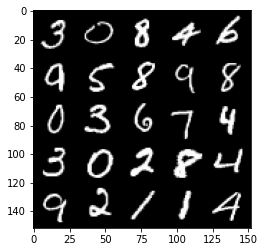

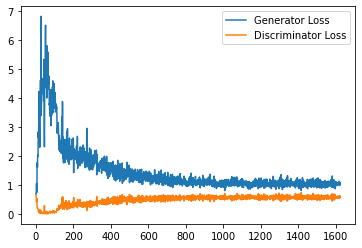

Step 33000: Generator loss: 1.0695785225629806, discriminator loss: 0.5763800222873687


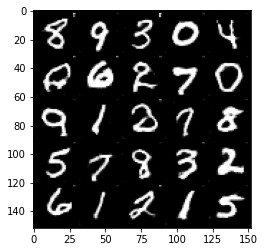

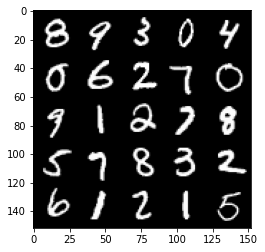

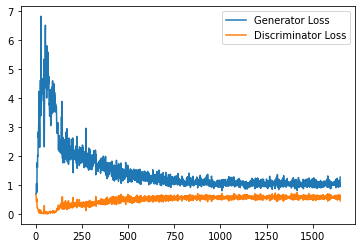

Step 33500: Generator loss: 1.0562573503255843, discriminator loss: 0.58658652728796


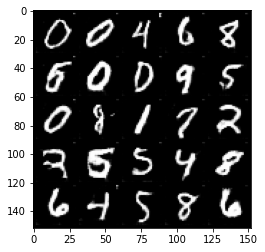

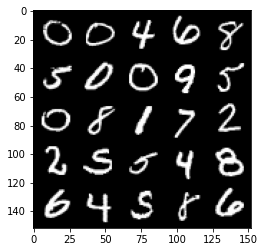

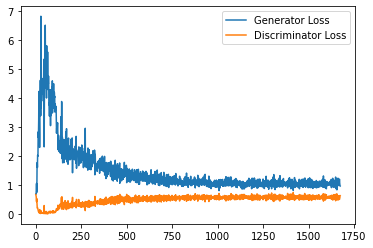

Step 34000: Generator loss: 1.0624039669036864, discriminator loss: 0.5776007114052772


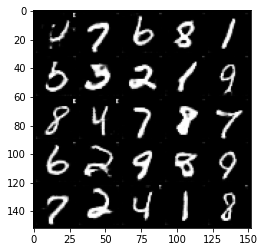

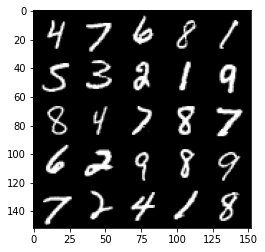

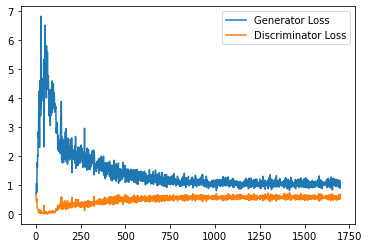

Step 34500: Generator loss: 1.054430753827095, discriminator loss: 0.5787325338721275


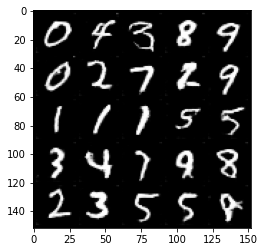

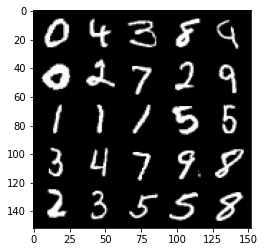

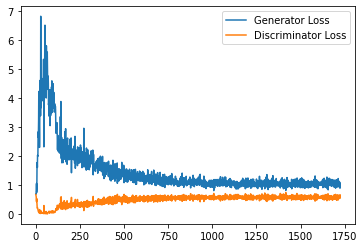

Step 35000: Generator loss: 1.0559649724960327, discriminator loss: 0.579733726143837


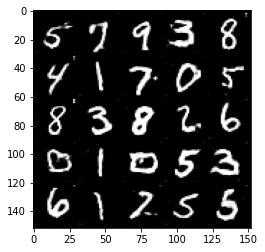

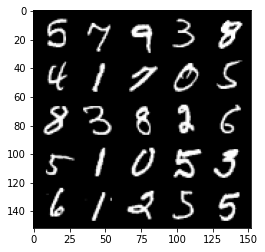

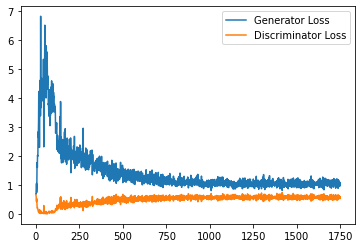

Step 35500: Generator loss: 1.0483347600698472, discriminator loss: 0.5787323331236839


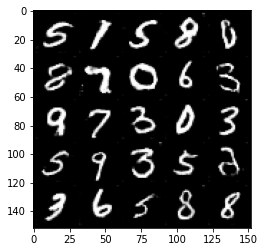

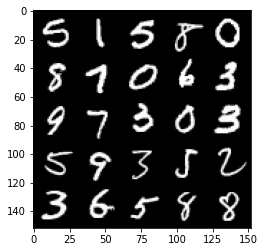

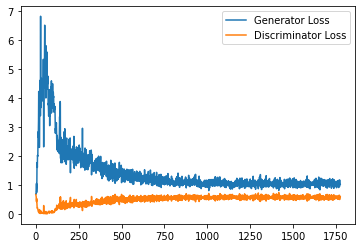

Step 36000: Generator loss: 1.0402258880138398, discriminator loss: 0.5790393808484078


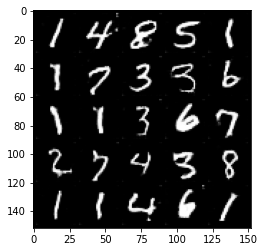

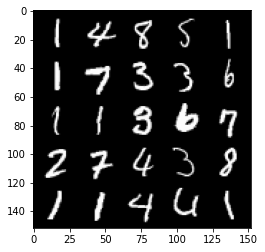

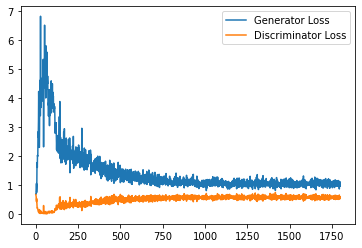

Step 36500: Generator loss: 1.0518346370458602, discriminator loss: 0.5785664522051811


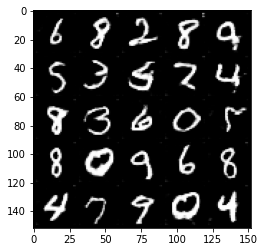

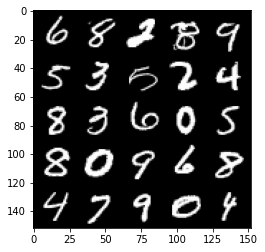

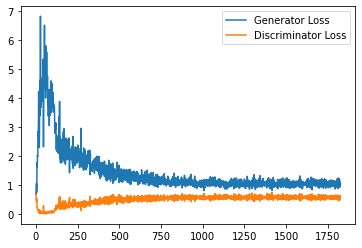

Step 37000: Generator loss: 1.0614913169145583, discriminator loss: 0.5850705437660217


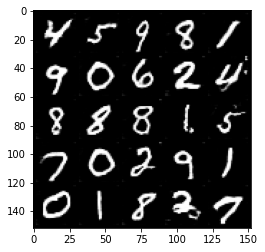

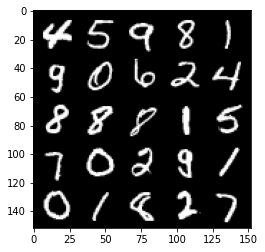

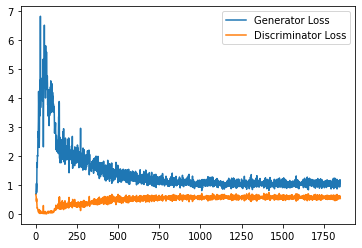

Step 37500: Generator loss: 1.0655978640317918, discriminator loss: 0.5828490740060807


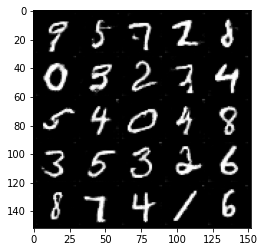

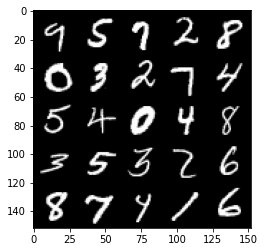

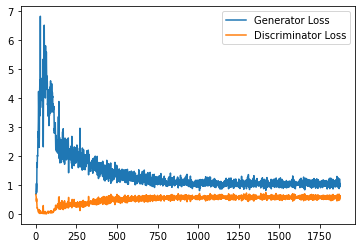

Step 38000: Generator loss: 1.0491684923171998, discriminator loss: 0.5794607102274895


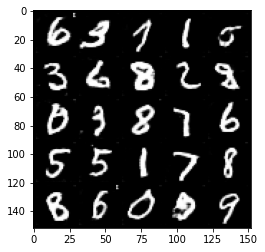

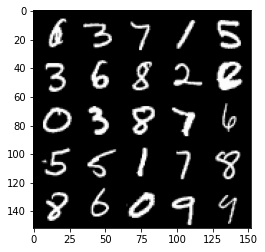

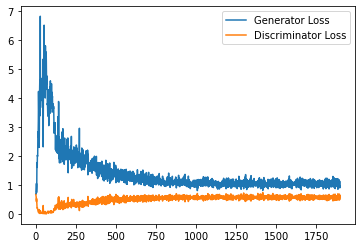

Step 38500: Generator loss: 1.0433605378866195, discriminator loss: 0.5768849486708642


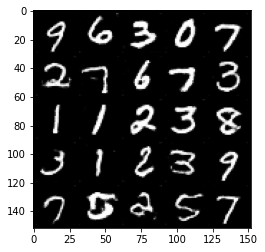

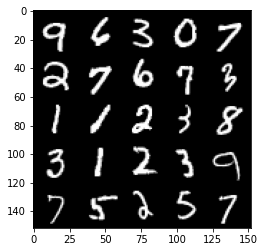

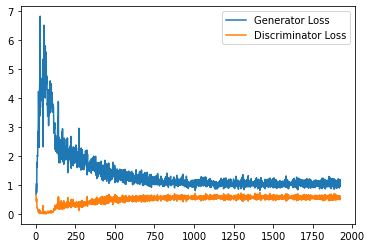

Step 39000: Generator loss: 1.0626800566911698, discriminator loss: 0.5751558104157448


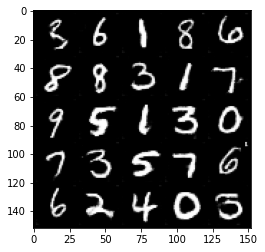

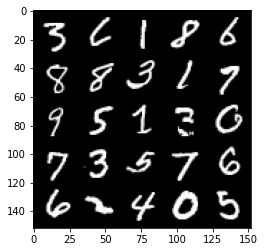

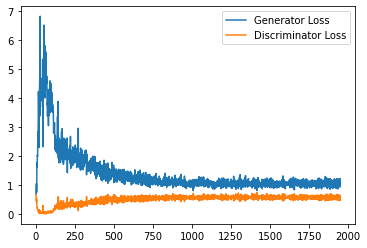

Step 39500: Generator loss: 1.0611236736774445, discriminator loss: 0.5758311121463776


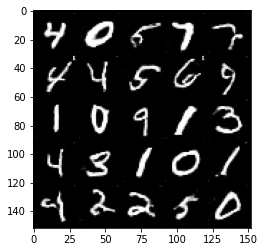

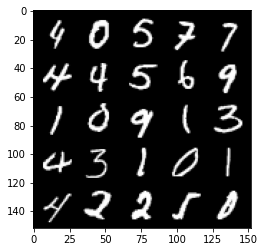

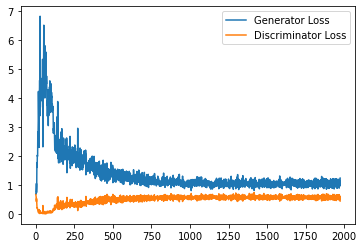

Step 40000: Generator loss: 1.0508752595186233, discriminator loss: 0.5806428477168083


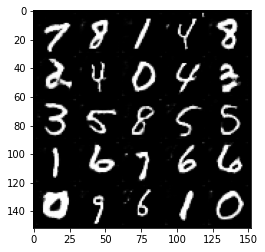

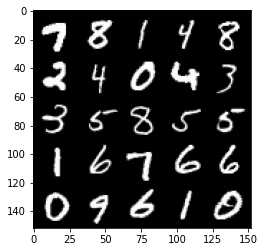

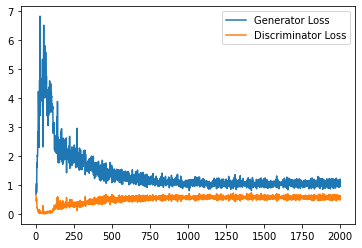

Step 40500: Generator loss: 1.078712000131607, discriminator loss: 0.574358550131321


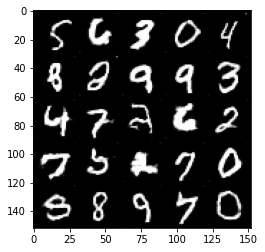

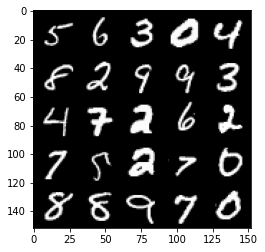

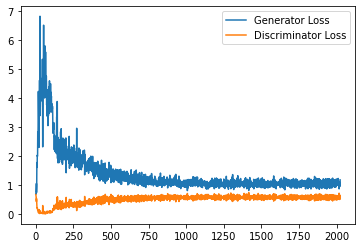

Step 41000: Generator loss: 1.055816460251808, discriminator loss: 0.5720531114339829


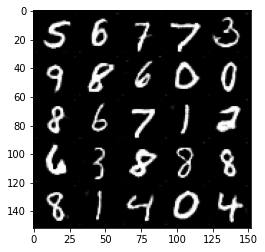

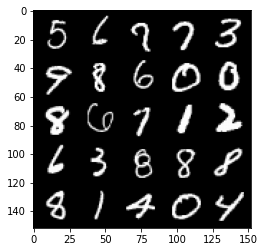

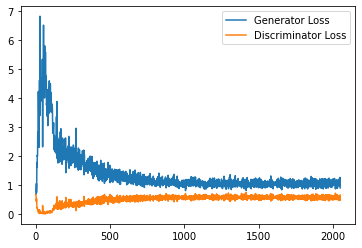

Step 41500: Generator loss: 1.0631248701810836, discriminator loss: 0.5796931325793266


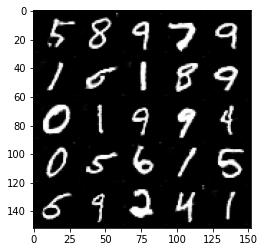

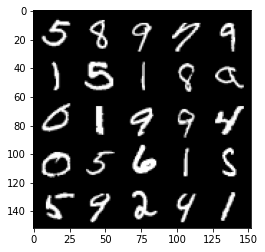

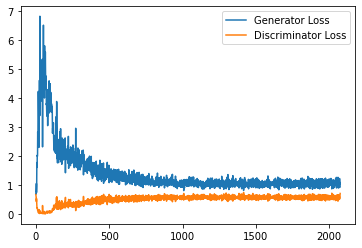

Step 42000: Generator loss: 1.0760061078071594, discriminator loss: 0.5690910000801086


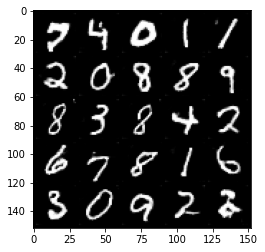

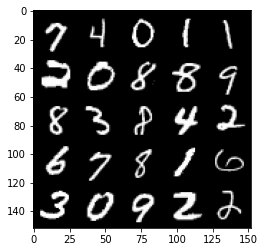

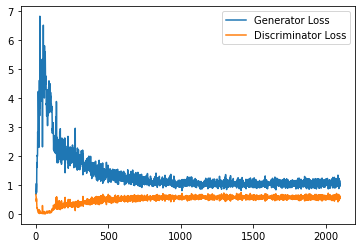

Step 42500: Generator loss: 1.0769105496406555, discriminator loss: 0.563480437040329


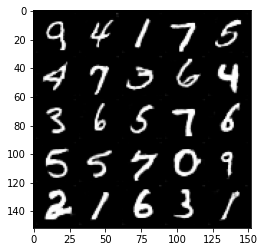

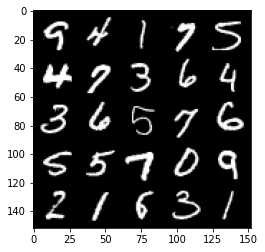

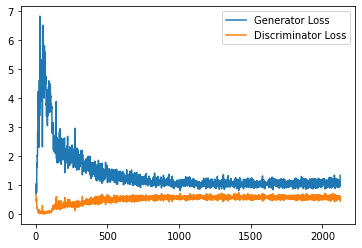

Step 43000: Generator loss: 1.0492511594295502, discriminator loss: 0.5737901338934899


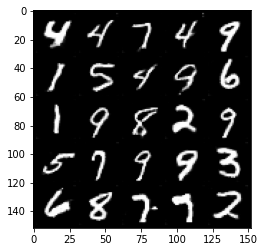

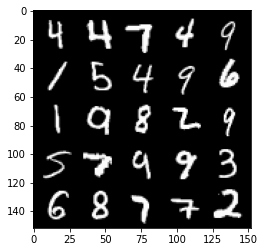

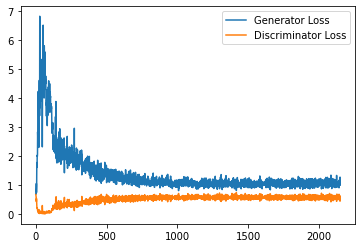

Step 43500: Generator loss: 1.0877317920923233, discriminator loss: 0.5700006884932518


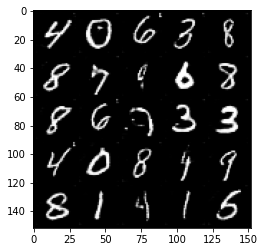

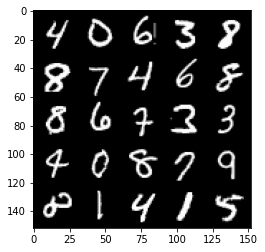

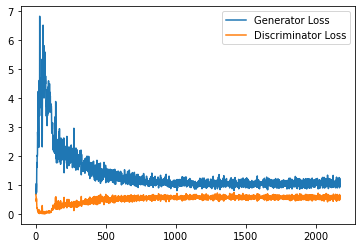

Step 44000: Generator loss: 1.1054199295043945, discriminator loss: 0.5629326165318489


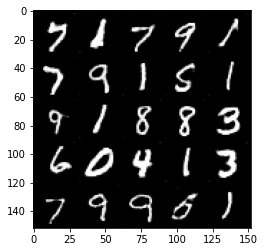

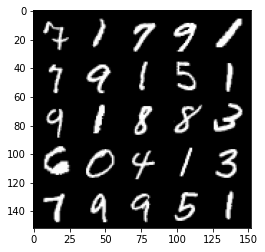

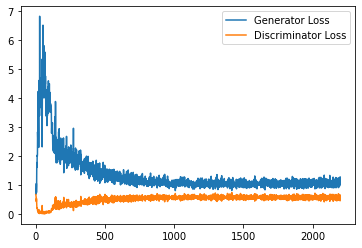

Step 44500: Generator loss: 1.0588069751262665, discriminator loss: 0.5752757152915001


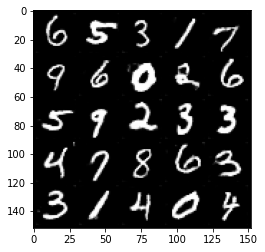

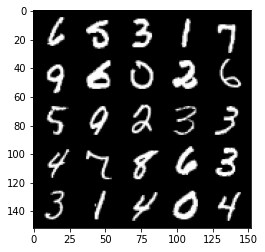

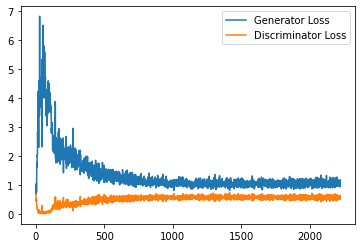

Step 45000: Generator loss: 1.0780708236694336, discriminator loss: 0.5668019015192985


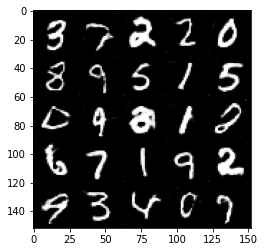

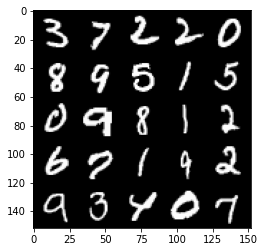

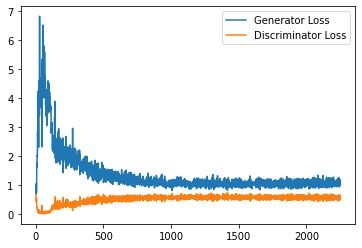

Step 45500: Generator loss: 1.0987975548505784, discriminator loss: 0.5578501968383789


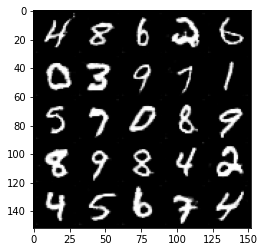

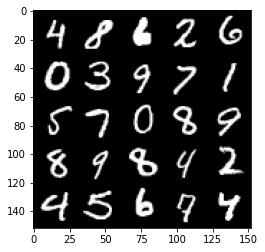

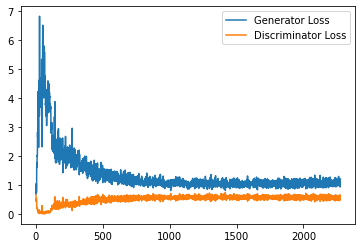

Step 46000: Generator loss: 1.1013911736011506, discriminator loss: 0.5599337550997734


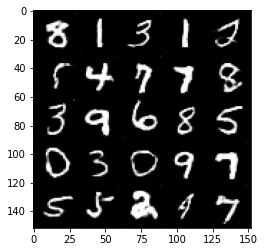

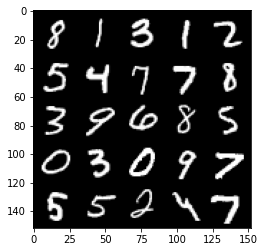

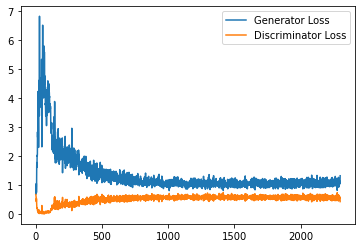

Step 46500: Generator loss: 1.0813324987888335, discriminator loss: 0.5669189267754555


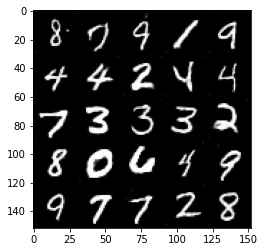

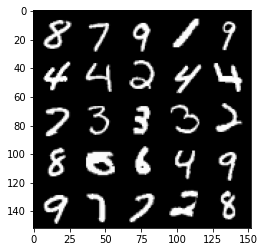

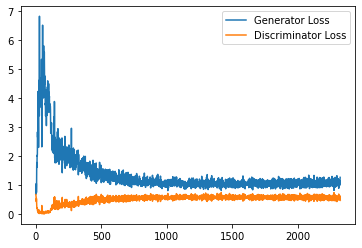

Step 47000: Generator loss: 1.0743075788021088, discriminator loss: 0.5676998869776726


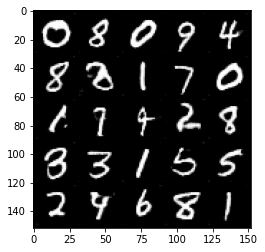

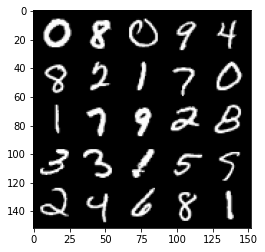

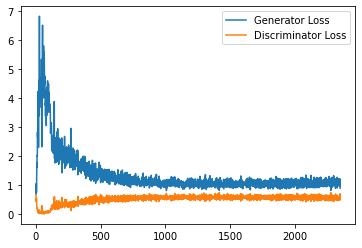

Step 47500: Generator loss: 1.0889606552124023, discriminator loss: 0.5594731765985489


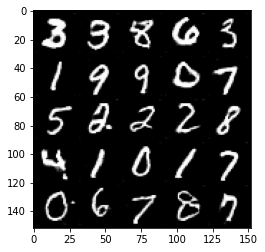

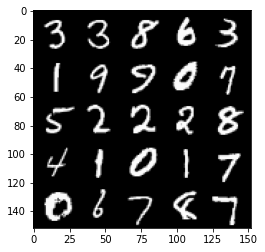

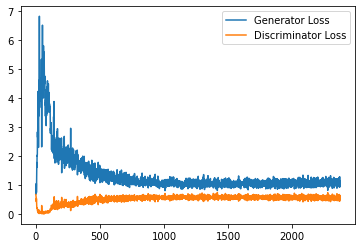

Step 48000: Generator loss: 1.0920014827251434, discriminator loss: 0.5616569739580154


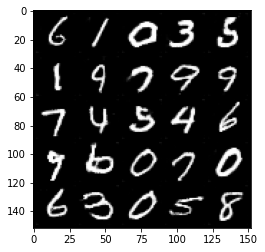

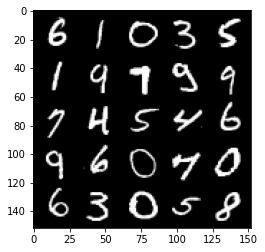

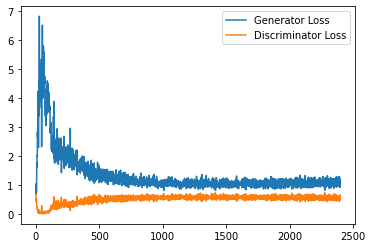

Step 48500: Generator loss: 1.108799590587616, discriminator loss: 0.5523292199969292


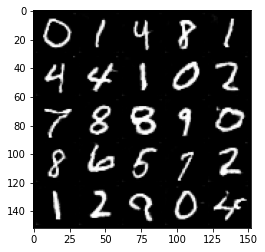

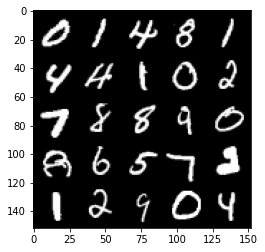

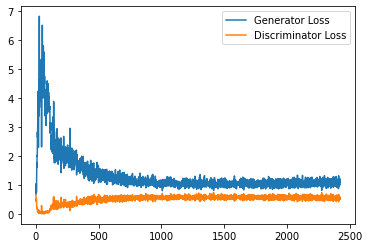

Step 49000: Generator loss: 1.0980789295434952, discriminator loss: 0.5639192216992378


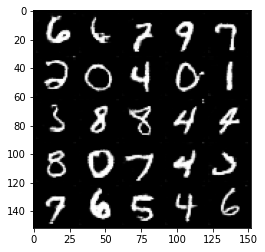

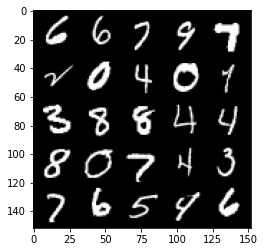

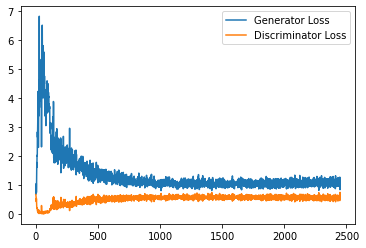

Step 49500: Generator loss: 1.1096751906871796, discriminator loss: 0.5561430914402008


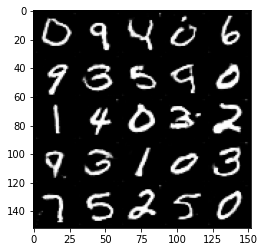

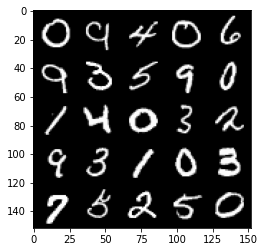

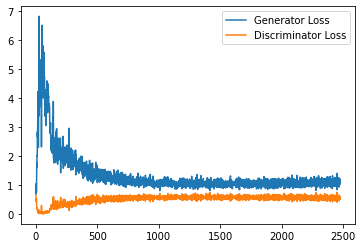

Step 50000: Generator loss: 1.1095782794952394, discriminator loss: 0.5616026943922043


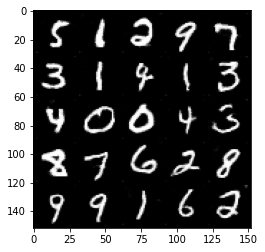

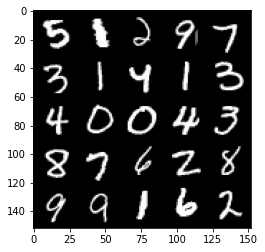

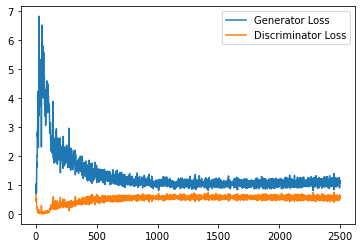

Step 50500: Generator loss: 1.1265190806388854, discriminator loss: 0.5537087537646294


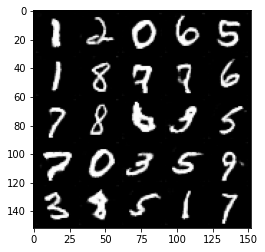

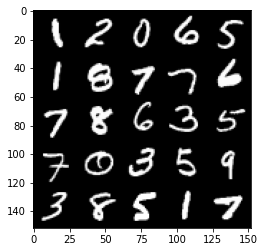

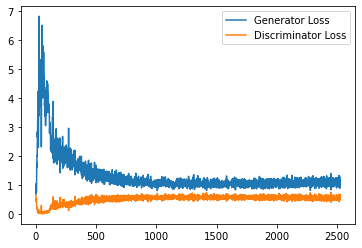

Step 51000: Generator loss: 1.1109196017980576, discriminator loss: 0.5544801233410835


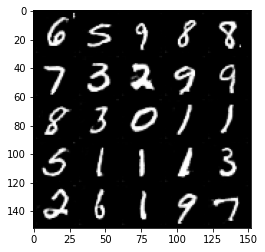

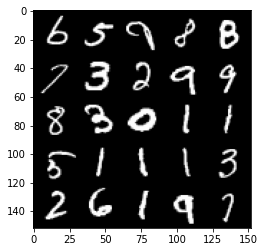

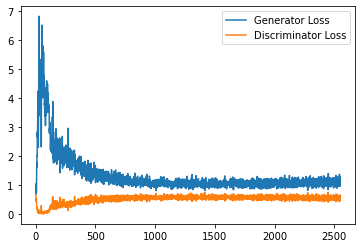

Step 51500: Generator loss: 1.0938197002410888, discriminator loss: 0.556761950135231


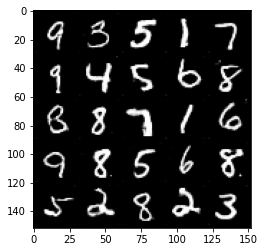

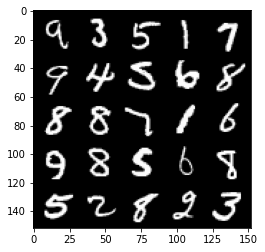

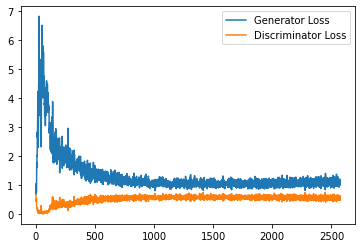

Step 52000: Generator loss: 1.1165872534513475, discriminator loss: 0.5513878706097602


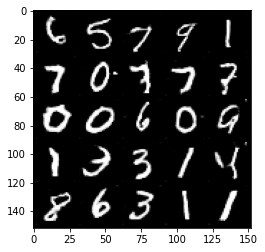

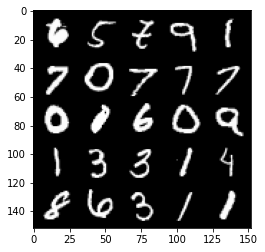

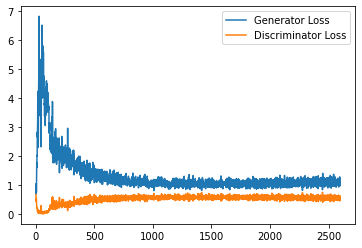

Step 52500: Generator loss: 1.1010320125818251, discriminator loss: 0.5549952571988106


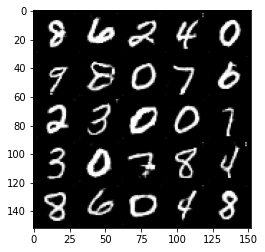

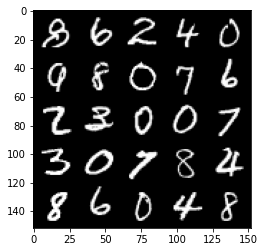

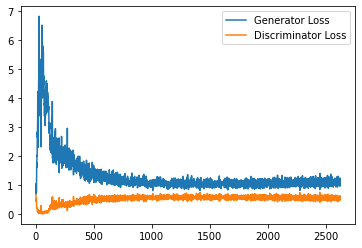

Step 53000: Generator loss: 1.1124977198839188, discriminator loss: 0.5540696359276771


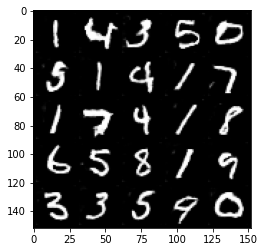

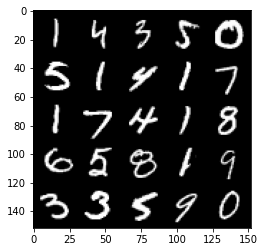

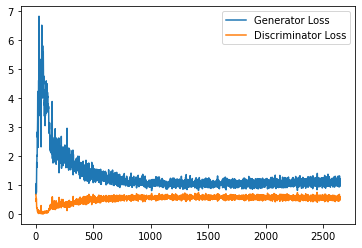

Step 53500: Generator loss: 1.1261662850379943, discriminator loss: 0.5470751020908355


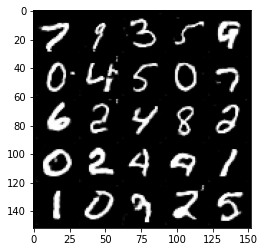

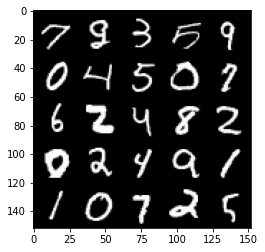

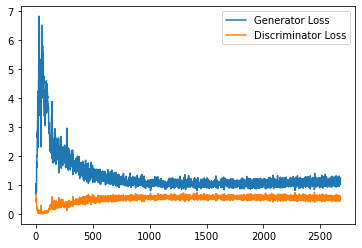

Step 54000: Generator loss: 1.1273649002313615, discriminator loss: 0.5541824812889099


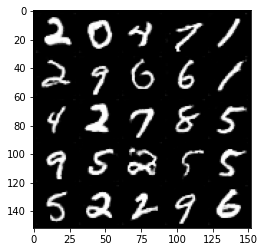

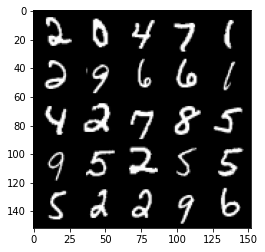

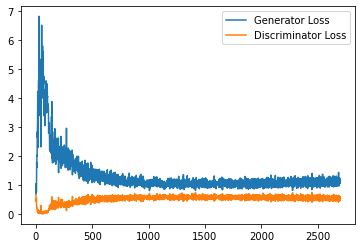

Step 54500: Generator loss: 1.1124590669870376, discriminator loss: 0.545369720697403


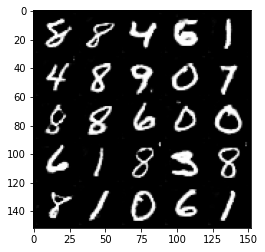

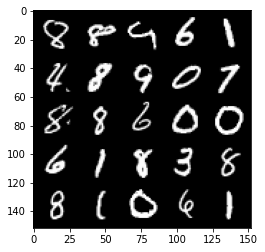

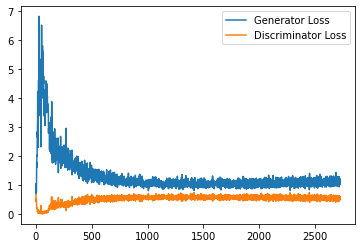

Step 55000: Generator loss: 1.119392946958542, discriminator loss: 0.5494233739972114


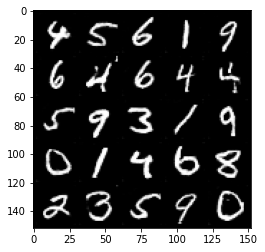

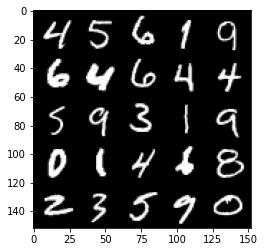

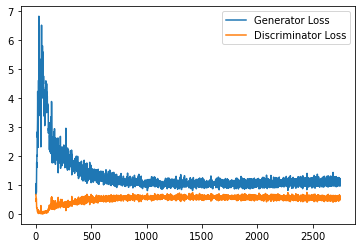

Step 55500: Generator loss: 1.1213982474803925, discriminator loss: 0.5461962698698044


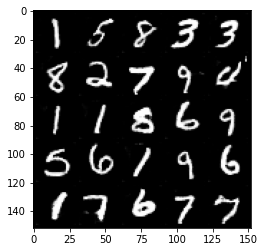

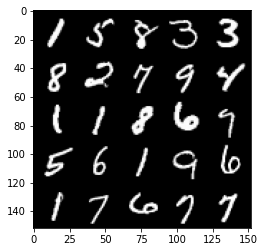

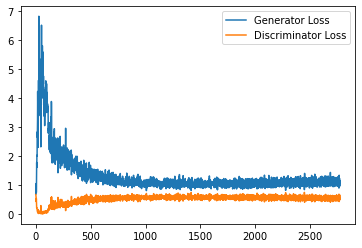

Step 56000: Generator loss: 1.1386124758720397, discriminator loss: 0.5493618500828743


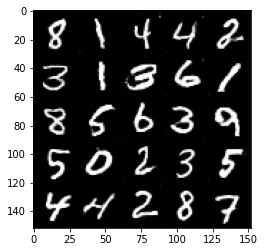

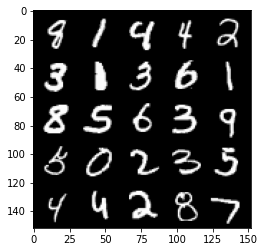

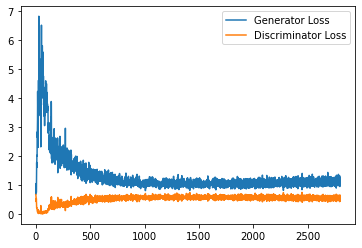

Step 56500: Generator loss: 1.121707938194275, discriminator loss: 0.5493366591334343


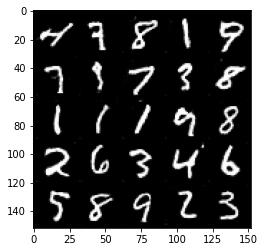

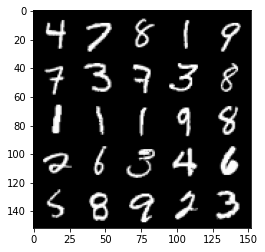

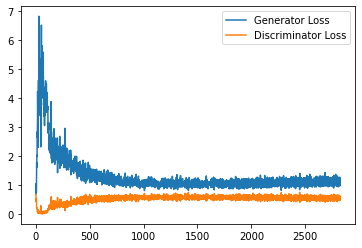

Step 57000: Generator loss: 1.1371617012023927, discriminator loss: 0.5432770994901657


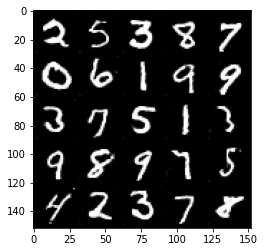

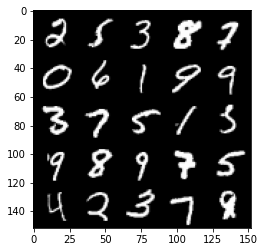

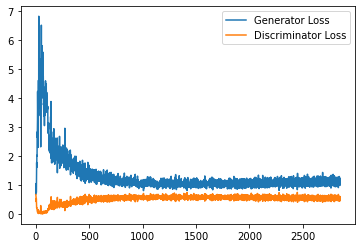

Step 57500: Generator loss: 1.143381819486618, discriminator loss: 0.5477437611222267


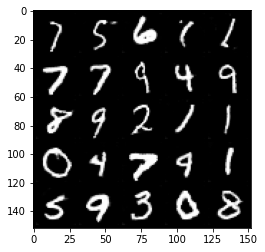

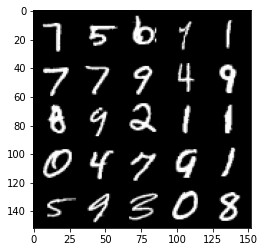

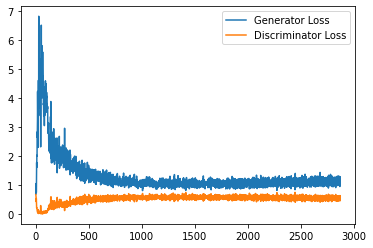

Step 58000: Generator loss: 1.1351176956892013, discriminator loss: 0.5524810114502907


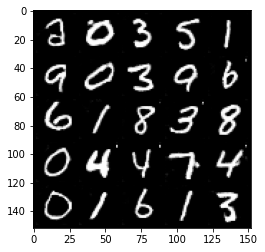

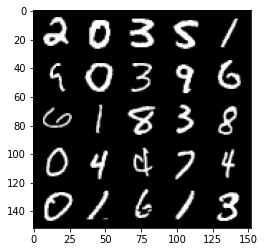

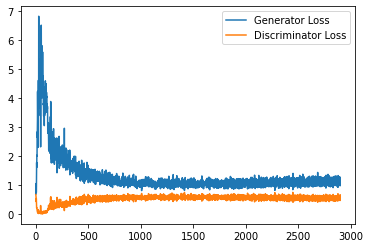

Step 58500: Generator loss: 1.1465888543128968, discriminator loss: 0.5460743263959885


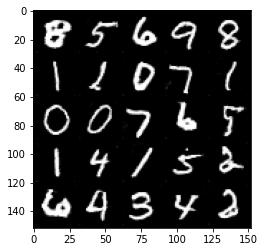

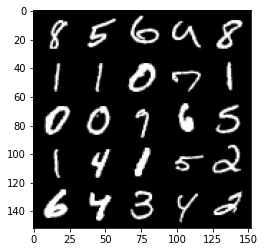

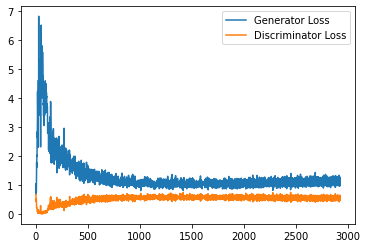

Step 59000: Generator loss: 1.1441168825626373, discriminator loss: 0.5410044864416123


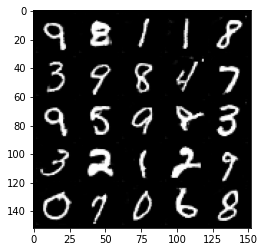

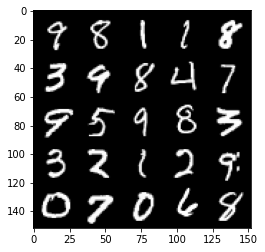

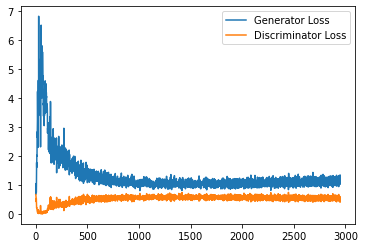

Step 59500: Generator loss: 1.1447976667881012, discriminator loss: 0.5441594418287278


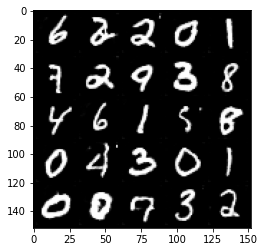

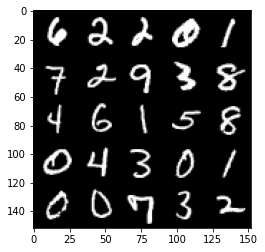

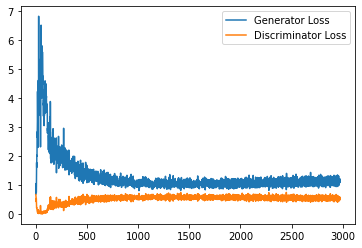

Step 60000: Generator loss: 1.1393509111404418, discriminator loss: 0.542315290927887


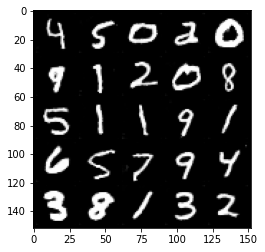

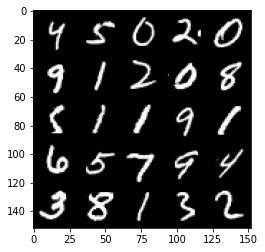

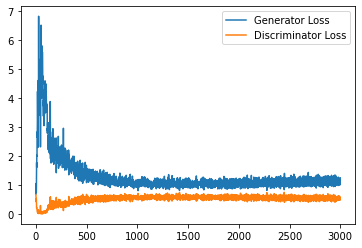

Step 60500: Generator loss: 1.1367777463197708, discriminator loss: 0.5410530948638916


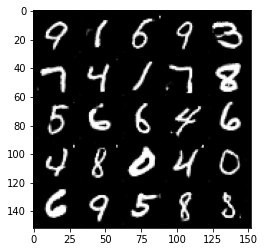

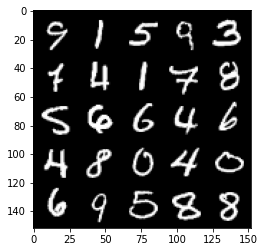

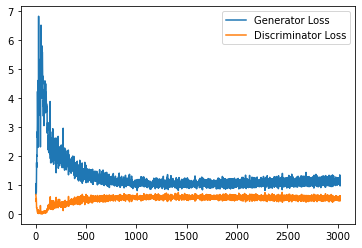

Step 61000: Generator loss: 1.1573139069080354, discriminator loss: 0.5408686565160752


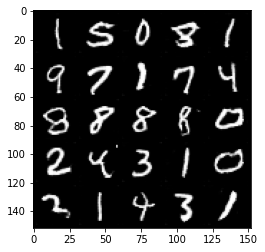

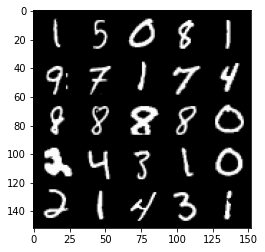

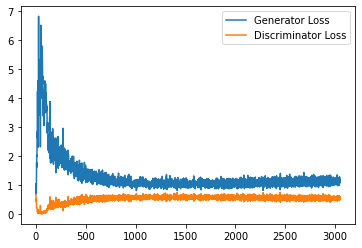

Step 61500: Generator loss: 1.1424284347295761, discriminator loss: 0.5395755780935287


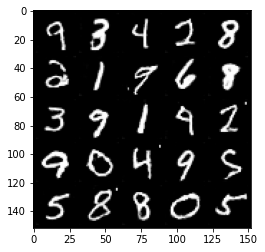

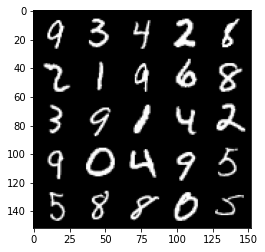

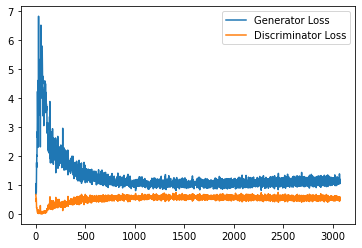

Step 62000: Generator loss: 1.1499139350652694, discriminator loss: 0.5439719916582108


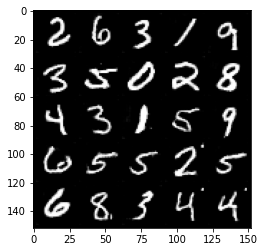

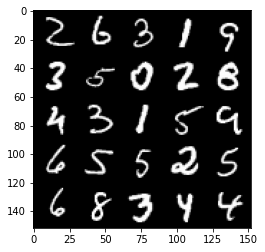

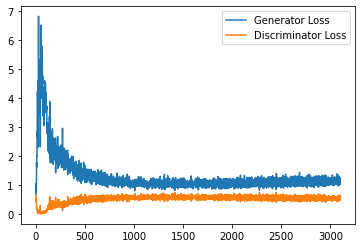

Step 62500: Generator loss: 1.1592630877494812, discriminator loss: 0.539361341059208


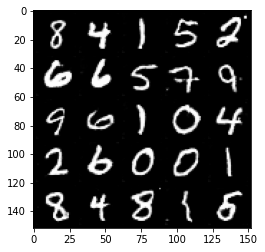

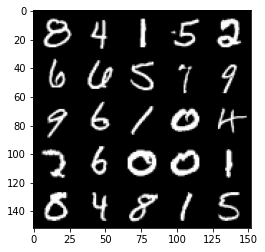

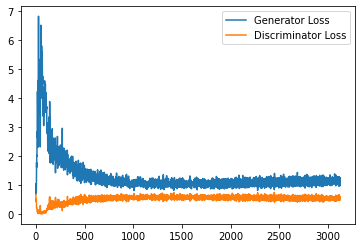

Step 63000: Generator loss: 1.138771688222885, discriminator loss: 0.5407439884543419


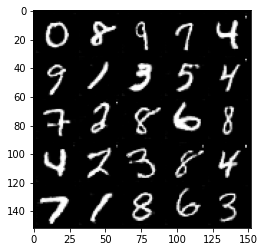

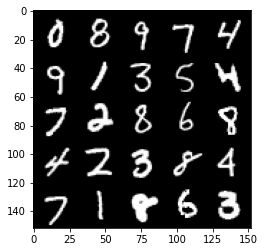

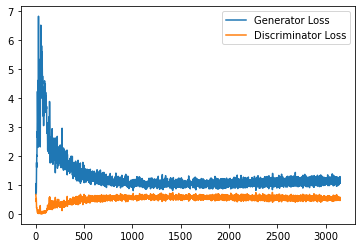

Step 63500: Generator loss: 1.166065761089325, discriminator loss: 0.5386847290992737


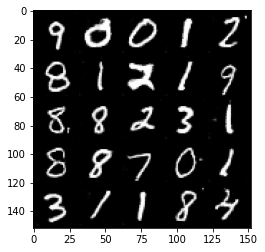

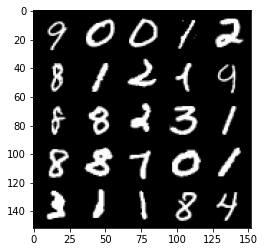

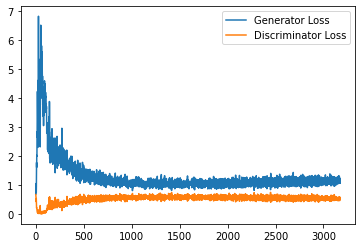

Step 64000: Generator loss: 1.1586749658584594, discriminator loss: 0.5400651627779007


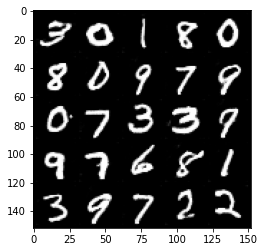

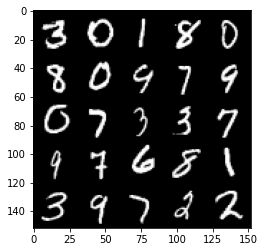

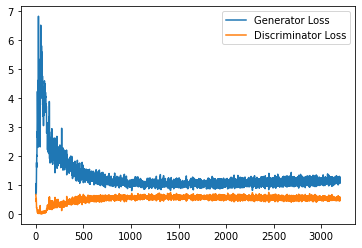

Step 64500: Generator loss: 1.1682273520231248, discriminator loss: 0.5385720711350441


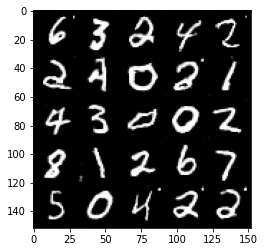

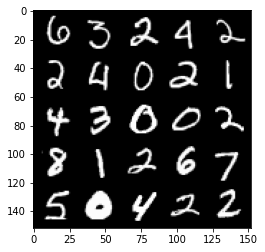

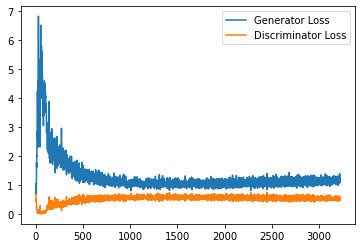

Step 65000: Generator loss: 1.1505091854333878, discriminator loss: 0.5347005296349525


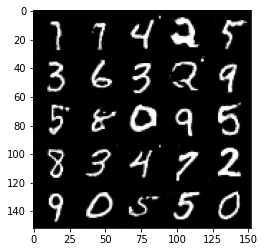

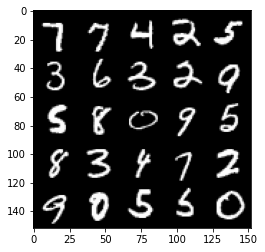

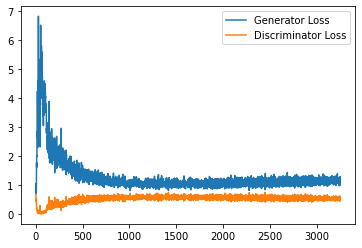

Step 65500: Generator loss: 1.1523632152080536, discriminator loss: 0.5416484184861183


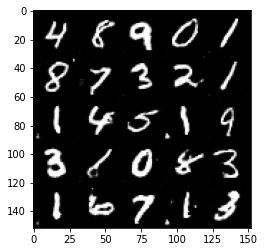

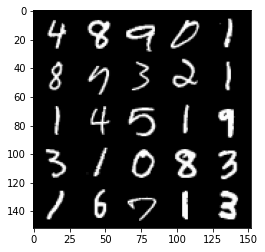

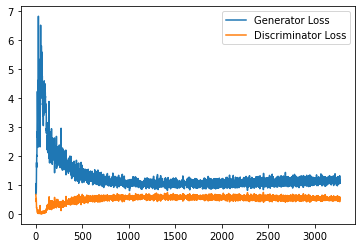

Step 66000: Generator loss: 1.1628163964748384, discriminator loss: 0.5338928954005241


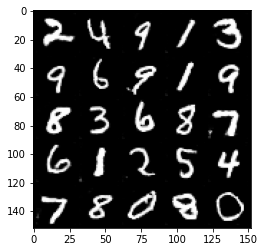

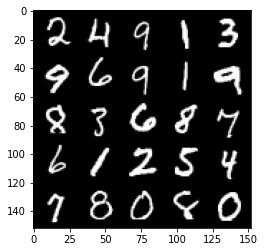

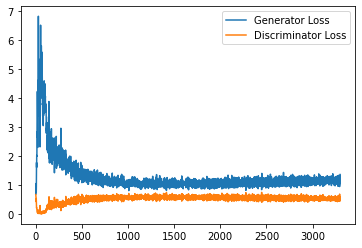

Step 66500: Generator loss: 1.1669935269355773, discriminator loss: 0.5437296640276909


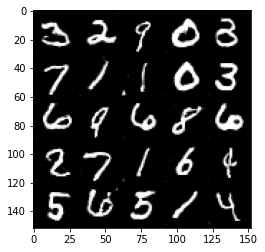

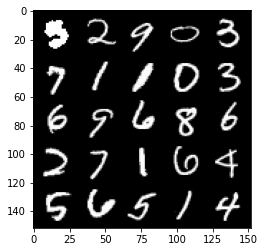

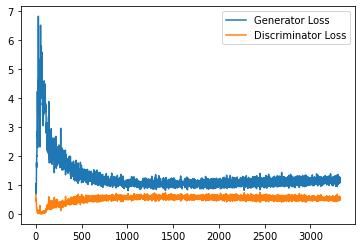

Step 67000: Generator loss: 1.1657072793245316, discriminator loss: 0.5386065310835838


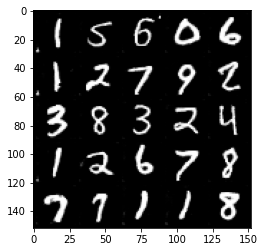

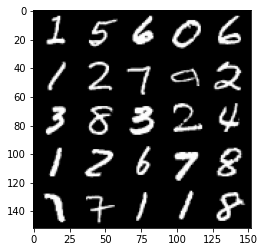

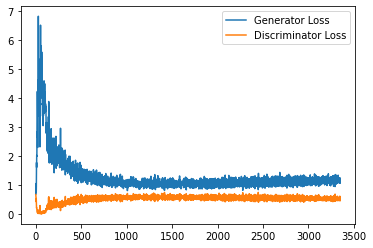

Step 67500: Generator loss: 1.1762293571233748, discriminator loss: 0.5373194105625153


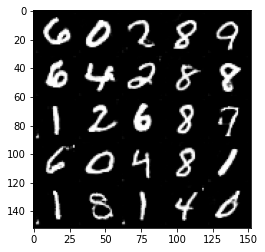

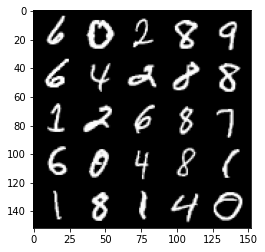

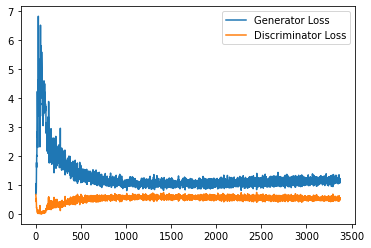

Step 68000: Generator loss: 1.1601777007579803, discriminator loss: 0.5336760608553887


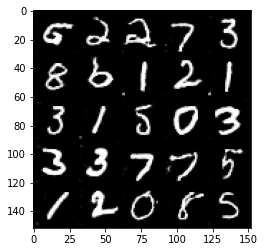

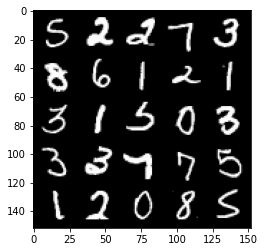

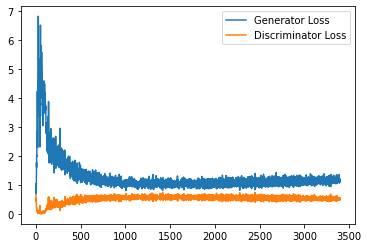

Step 68500: Generator loss: 1.1564131016731263, discriminator loss: 0.5385413042902947


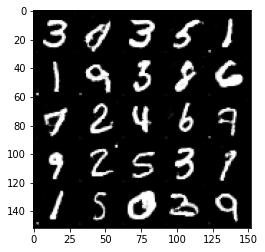

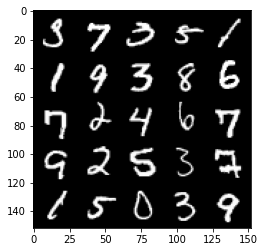

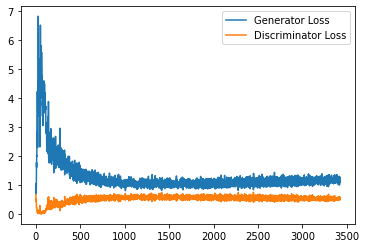

Step 69000: Generator loss: 1.1701608604192735, discriminator loss: 0.5318833121657371


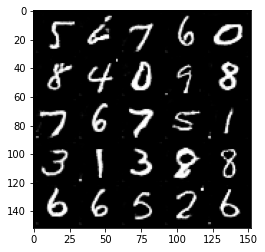

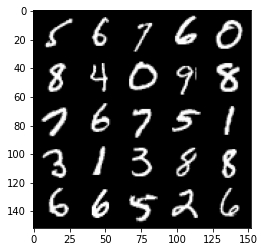

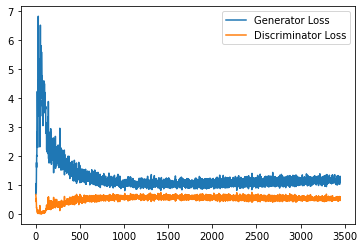

Step 69500: Generator loss: 1.1682200527191162, discriminator loss: 0.5413322600722313


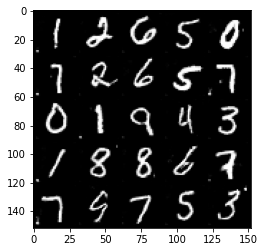

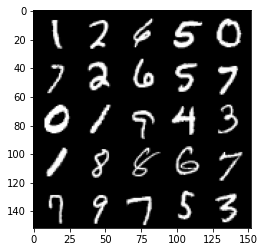

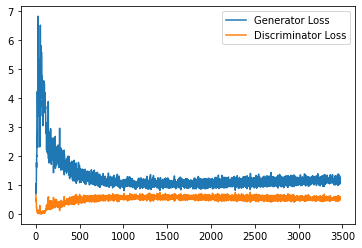

Step 70000: Generator loss: 1.1548928334712982, discriminator loss: 0.5404390259385109


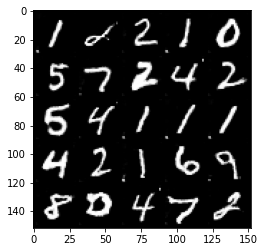

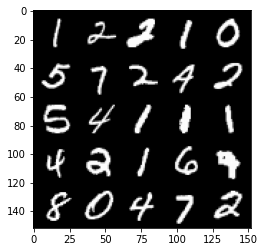

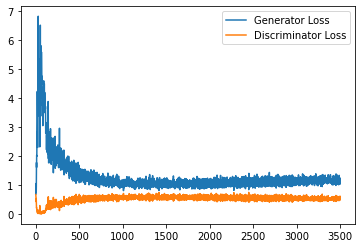

Step 70500: Generator loss: 1.1722190812826156, discriminator loss: 0.5359388750195503


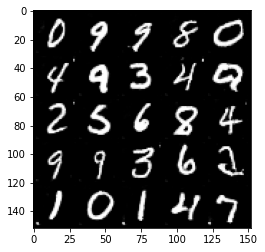

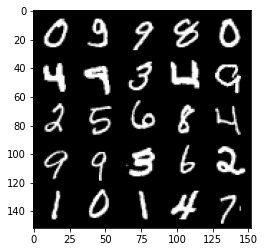

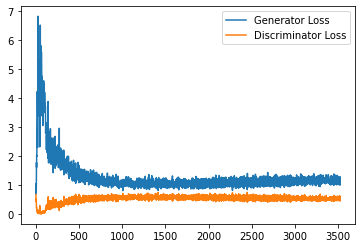

Step 71000: Generator loss: 1.163318613052368, discriminator loss: 0.5364770691990852


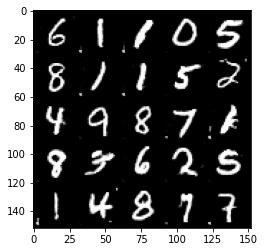

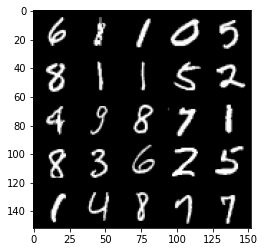

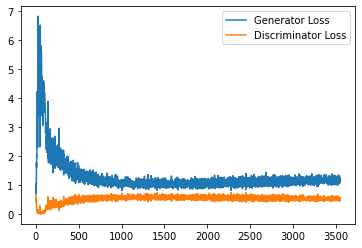

Step 71500: Generator loss: 1.174329625606537, discriminator loss: 0.5388199459314347


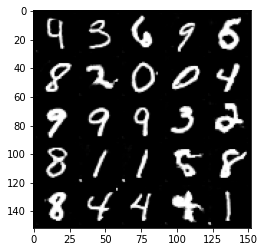

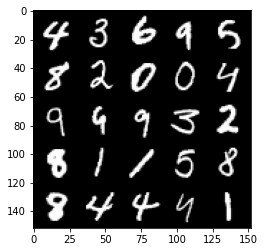

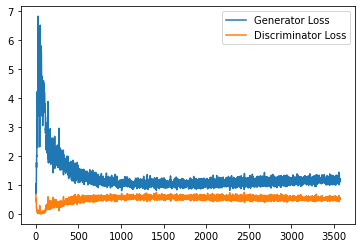

Step 72000: Generator loss: 1.1494938319921493, discriminator loss: 0.5404569692015648


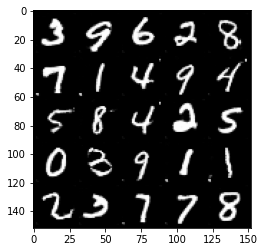

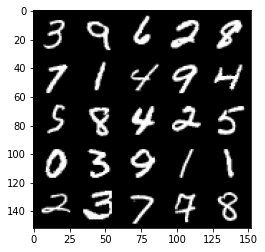

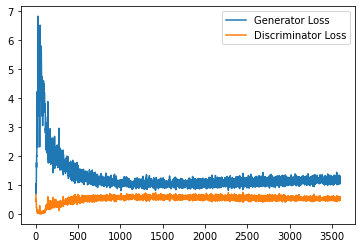

Step 72500: Generator loss: 1.1776793860197068, discriminator loss: 0.5427644599676132


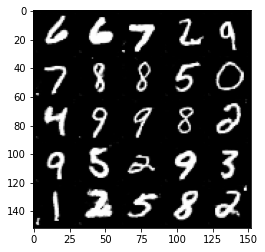

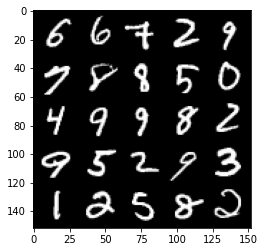

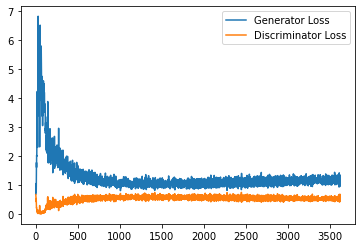

Step 73000: Generator loss: 1.1886332587003707, discriminator loss: 0.5353703234791756


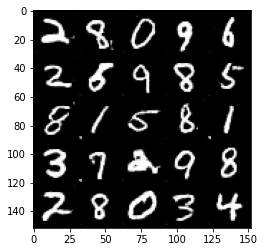

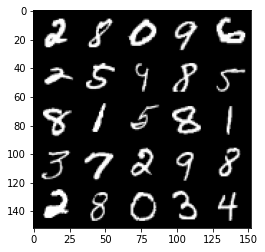

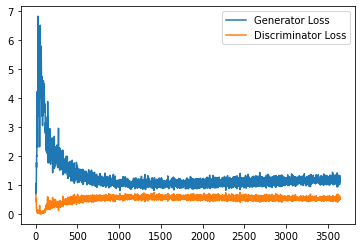

Step 73500: Generator loss: 1.1628485771417618, discriminator loss: 0.5432703046798706


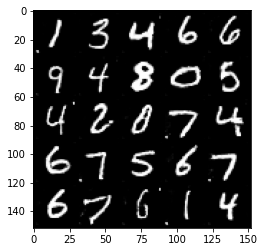

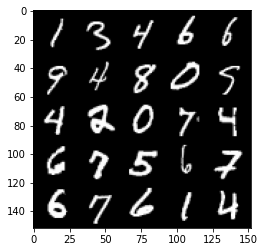

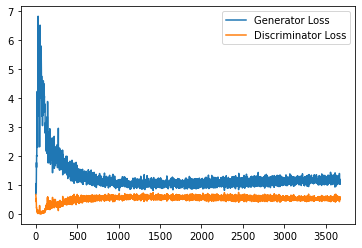

Step 74000: Generator loss: 1.1821602580547332, discriminator loss: 0.5392497314214706


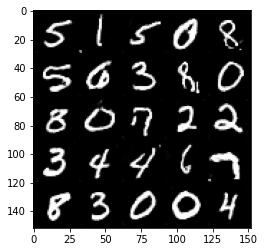

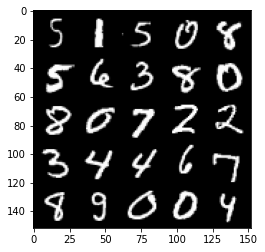

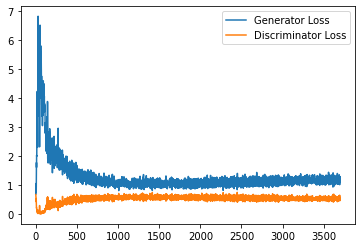

Step 74500: Generator loss: 1.1834733092784882, discriminator loss: 0.540979889690876


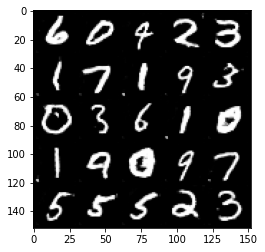

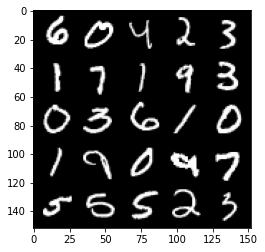

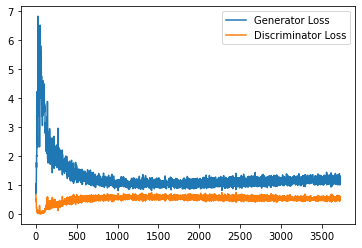

Step 75000: Generator loss: 1.1658760558366776, discriminator loss: 0.5376957211494445


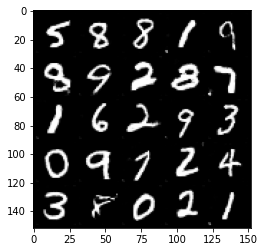

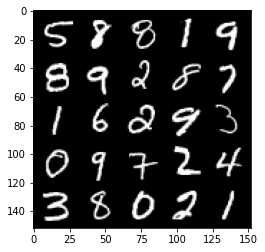

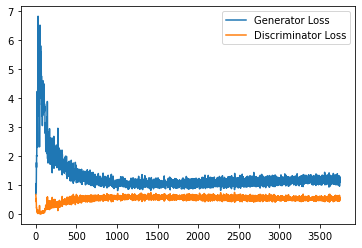

Step 75500: Generator loss: 1.1894593037366867, discriminator loss: 0.5365435288548469


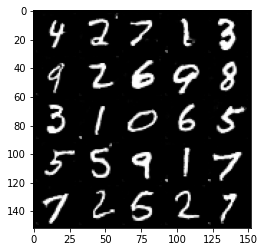

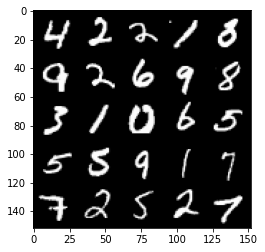

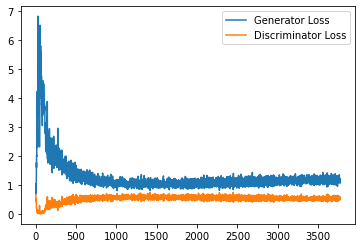

Step 76000: Generator loss: 1.1475941333770752, discriminator loss: 0.5403810797929763


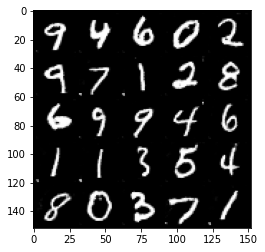

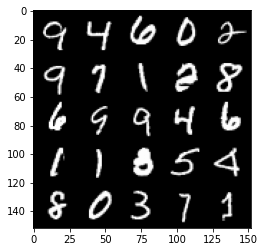

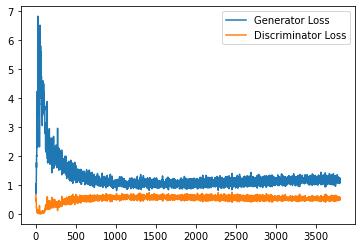

Step 76500: Generator loss: 1.1921735265254974, discriminator loss: 0.5354515379071235


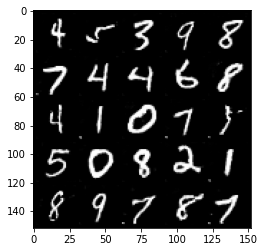

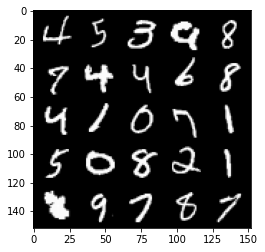

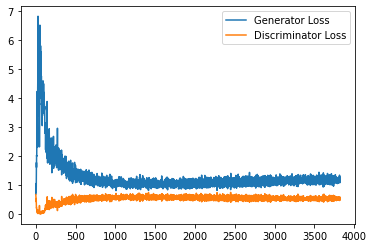

Step 77000: Generator loss: 1.167751851797104, discriminator loss: 0.5351852877140045


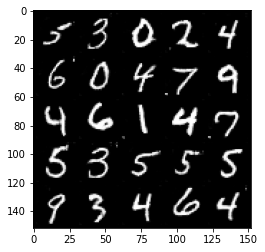

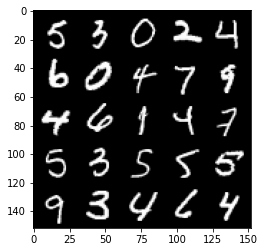

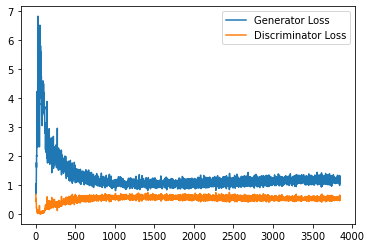

Step 77500: Generator loss: 1.1632260345220566, discriminator loss: 0.5420629830360413


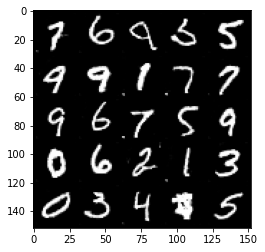

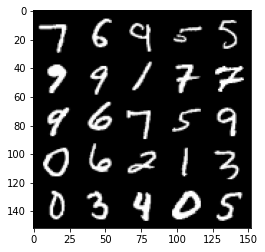

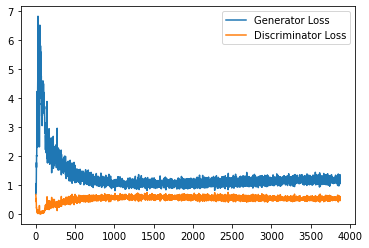

Step 78000: Generator loss: 1.1849750388860703, discriminator loss: 0.5325720044374466


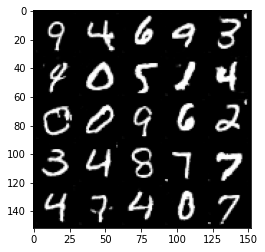

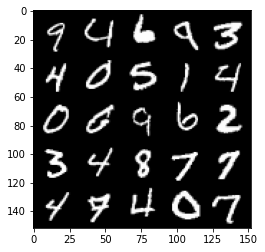

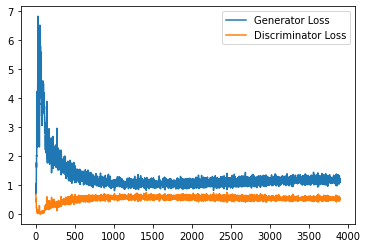

Step 78500: Generator loss: 1.1787126650810242, discriminator loss: 0.5367726591825486


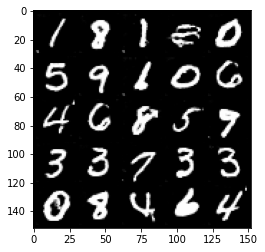

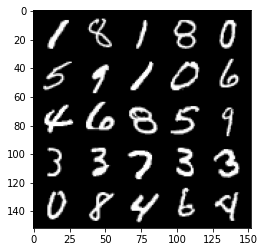

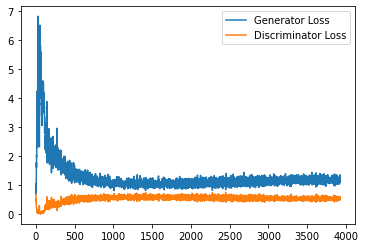

Step 79000: Generator loss: 1.1844880735874177, discriminator loss: 0.5318475940227508


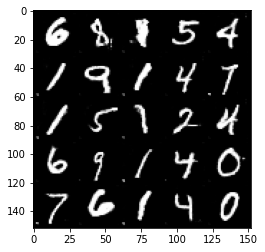

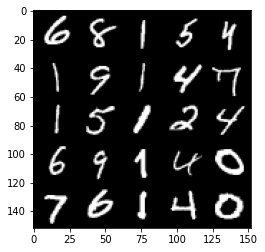

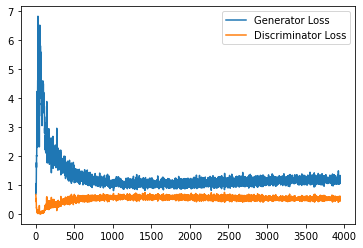

Step 79500: Generator loss: 1.1986392889022828, discriminator loss: 0.5402196918129921


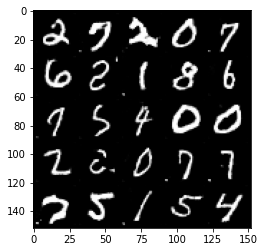

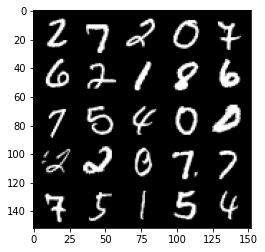

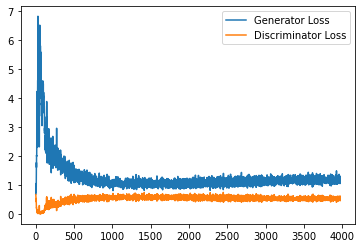

Step 80000: Generator loss: 1.1672290910482406, discriminator loss: 0.5415702946782112


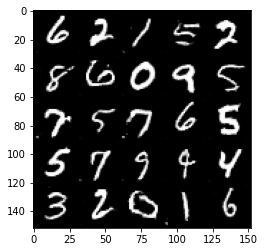

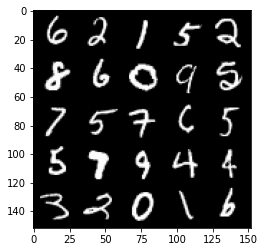

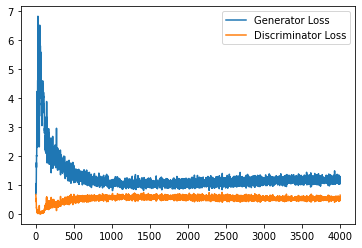

Step 80500: Generator loss: 1.183956171989441, discriminator loss: 0.536369465470314


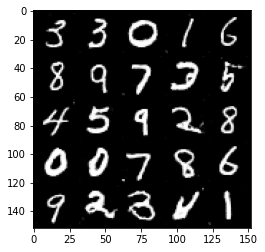

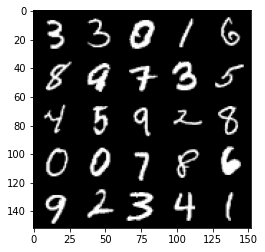

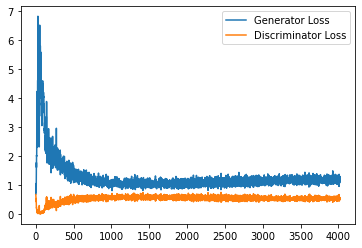

Step 81000: Generator loss: 1.2028511167764664, discriminator loss: 0.5362393791675568


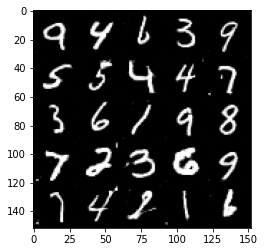

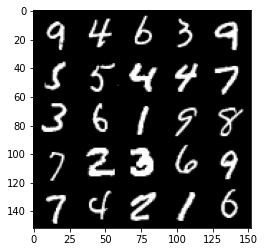

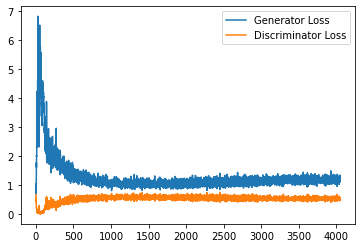

Step 81500: Generator loss: 1.186559219956398, discriminator loss: 0.5425966908335685


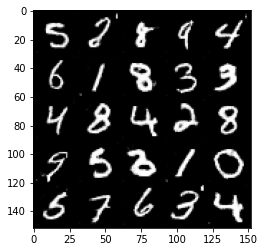

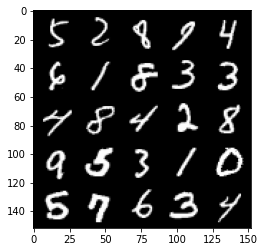

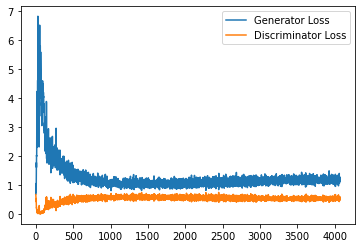

Step 82000: Generator loss: 1.1828272911310196, discriminator loss: 0.5354757813215256


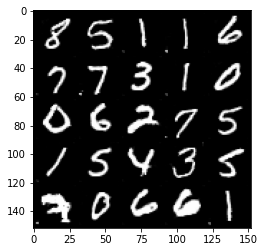

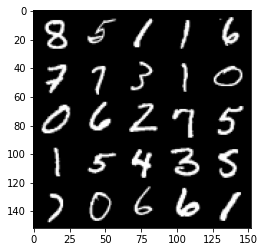

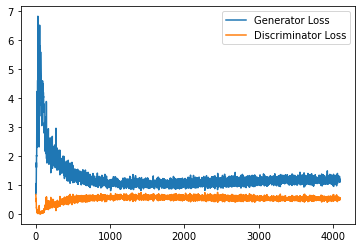

Step 82500: Generator loss: 1.1787585781812668, discriminator loss: 0.5392394395470619


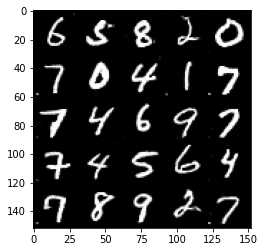

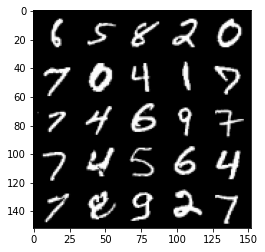

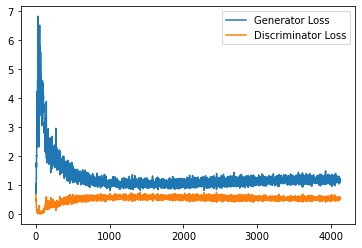

Step 83000: Generator loss: 1.197945729613304, discriminator loss: 0.5389284119009972


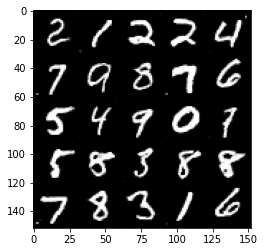

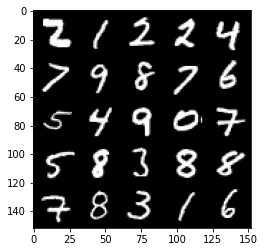

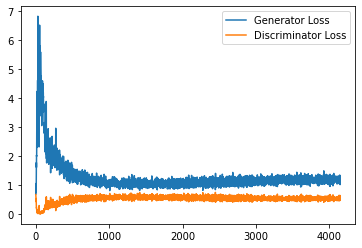

Step 83500: Generator loss: 1.1751692442893982, discriminator loss: 0.5413610433340073


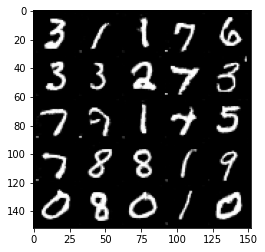

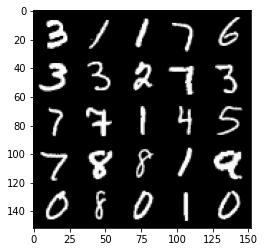

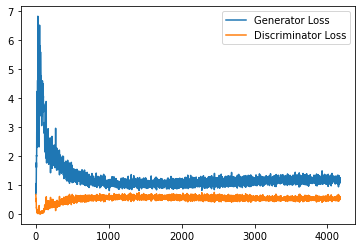

Step 84000: Generator loss: 1.1754168603420259, discriminator loss: 0.5451036501526833


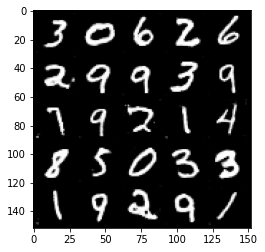

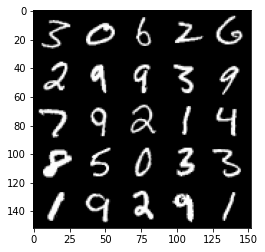

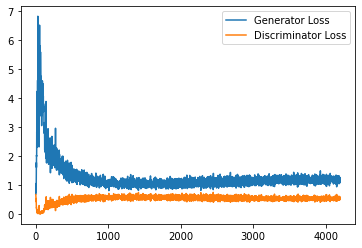

Step 84500: Generator loss: 1.1673727371692657, discriminator loss: 0.539283573448658


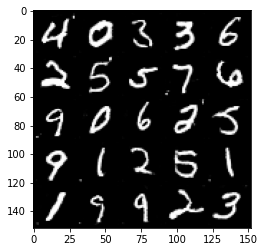

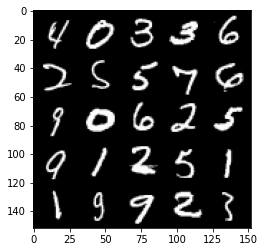

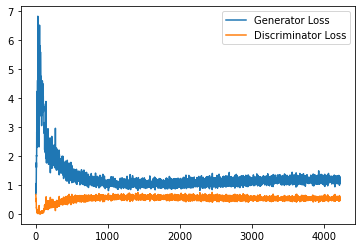

Step 85000: Generator loss: 1.1659385929107666, discriminator loss: 0.5391977459192276


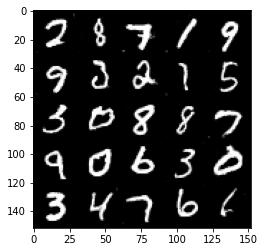

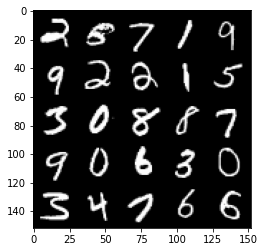

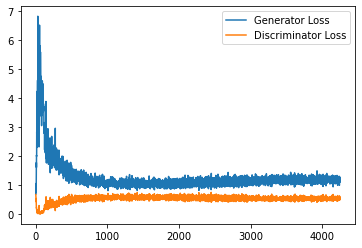

Step 85500: Generator loss: 1.174899554014206, discriminator loss: 0.5463236885070801


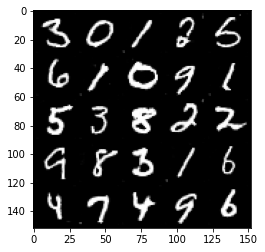

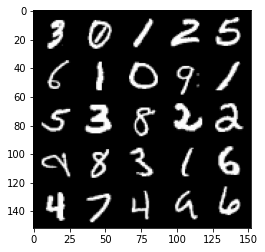

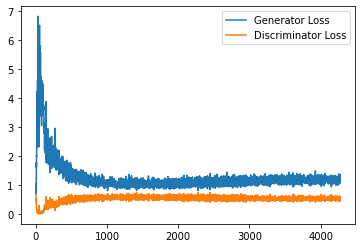

Step 86000: Generator loss: 1.1743305025100708, discriminator loss: 0.5449927650690078


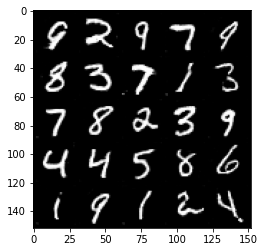

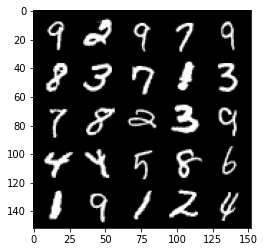

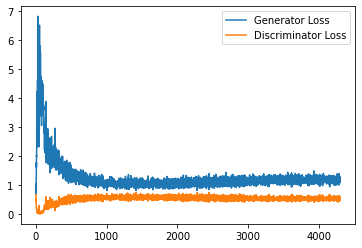

Step 86500: Generator loss: 1.1801248440742493, discriminator loss: 0.54102422529459


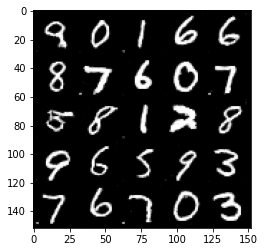

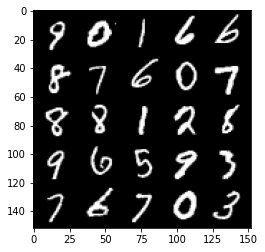

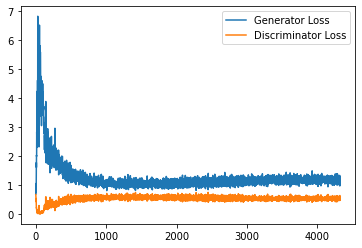

Step 87000: Generator loss: 1.1792453279495239, discriminator loss: 0.5448178542852402


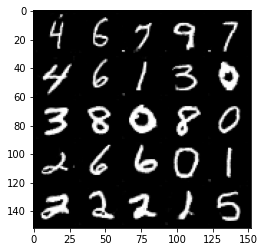

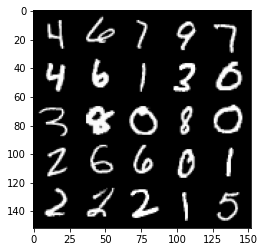

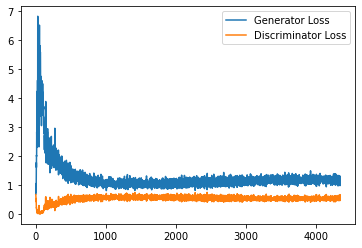

Step 87500: Generator loss: 1.1694510535001754, discriminator loss: 0.5565968498587608


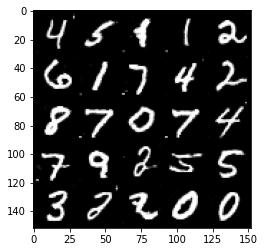

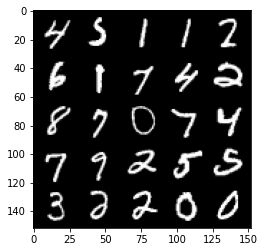

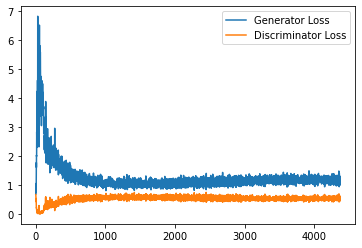

Step 88000: Generator loss: 1.1747906348705293, discriminator loss: 0.5493584480285645


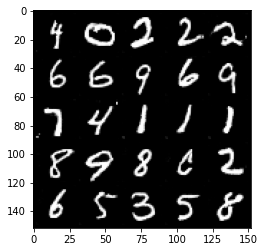

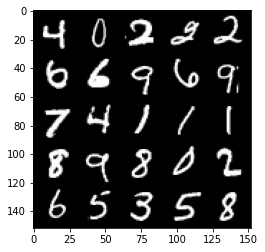

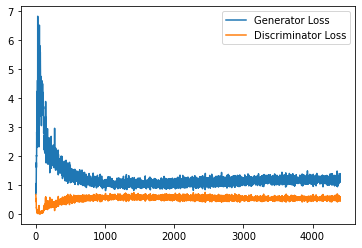

Step 88500: Generator loss: 1.1615703986883164, discriminator loss: 0.5487209375500679


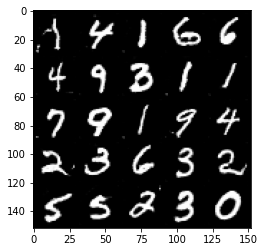

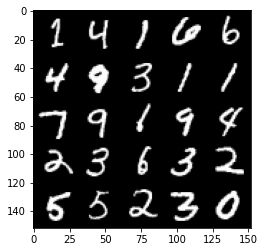

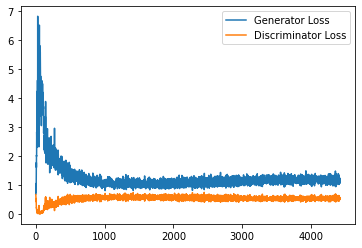

Step 89000: Generator loss: 1.1729369175434112, discriminator loss: 0.5413951615691185


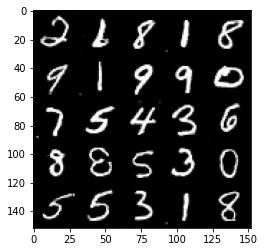

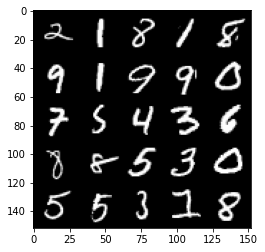

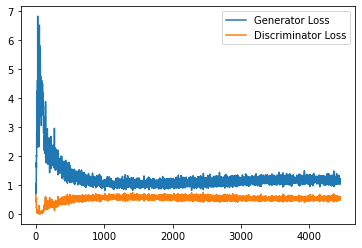

Step 89500: Generator loss: 1.1657010769844056, discriminator loss: 0.5433810388445854


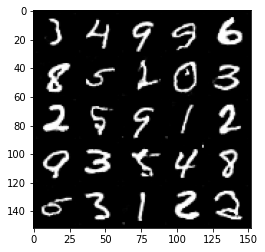

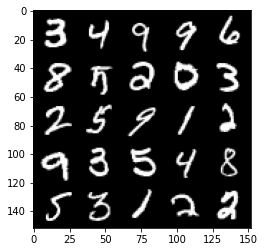

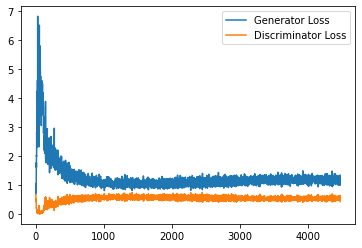

Step 90000: Generator loss: 1.1746042503118514, discriminator loss: 0.5488826966285706


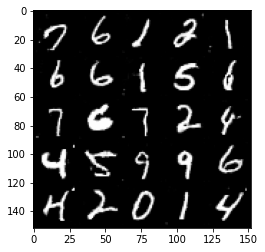

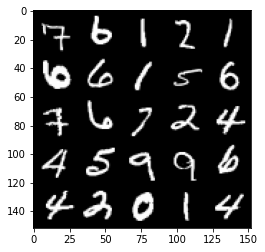

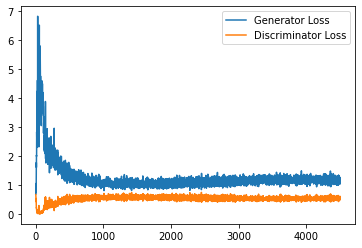

Step 90500: Generator loss: 1.1919225800037383, discriminator loss: 0.5486982630491257


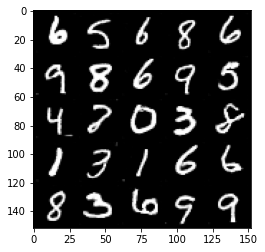

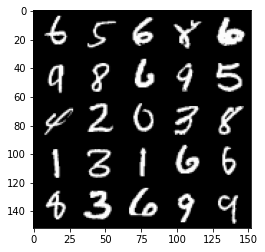

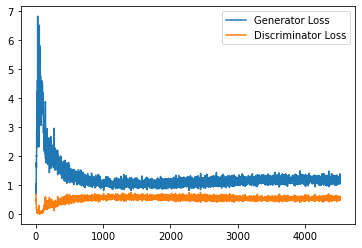

Step 91000: Generator loss: 1.1748127110004425, discriminator loss: 0.547987339258194


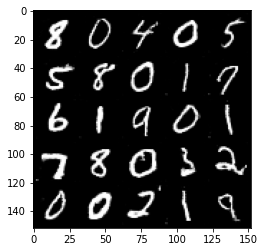

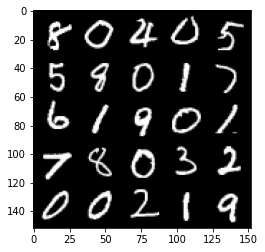

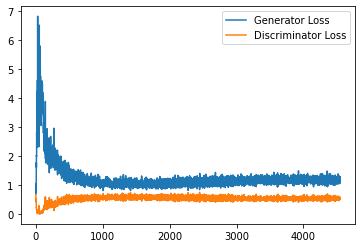

Step 91500: Generator loss: 1.1659146151542663, discriminator loss: 0.5559689302444458


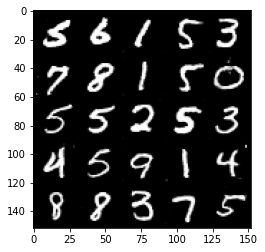

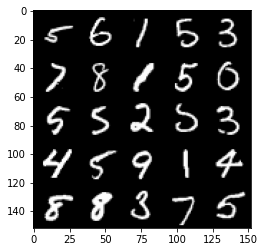

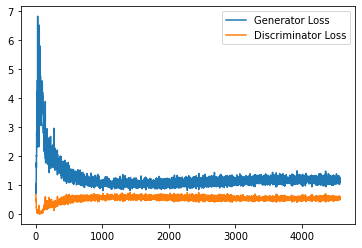

Step 92000: Generator loss: 1.1765166784524919, discriminator loss: 0.5518767627477645


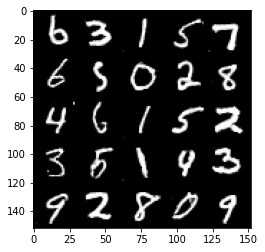

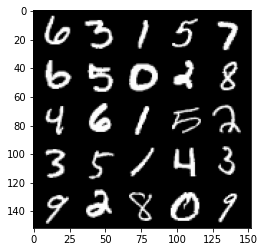

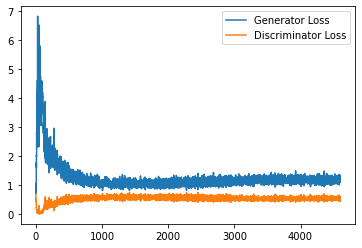

Step 92500: Generator loss: 1.1542316348552704, discriminator loss: 0.552485956788063


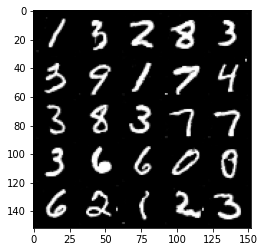

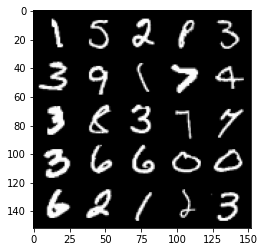

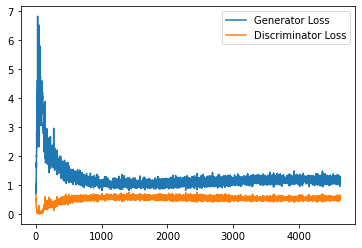

Step 93000: Generator loss: 1.159593672633171, discriminator loss: 0.5529335733652115


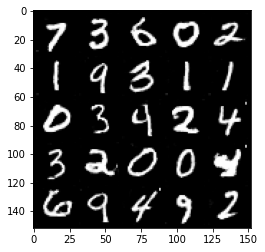

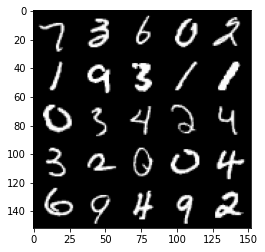

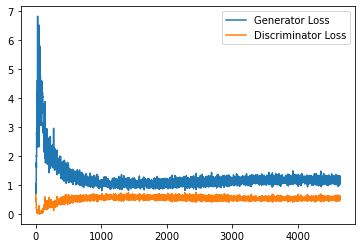

Step 93500: Generator loss: 1.154980232834816, discriminator loss: 0.5517836421728134


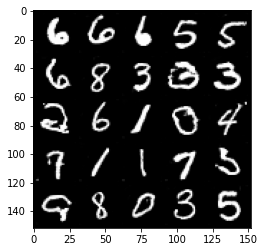

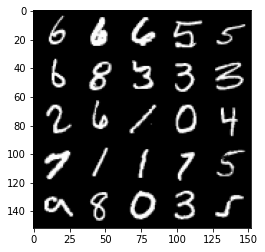

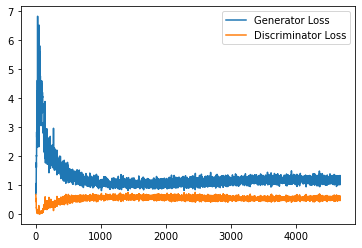

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen.forward(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

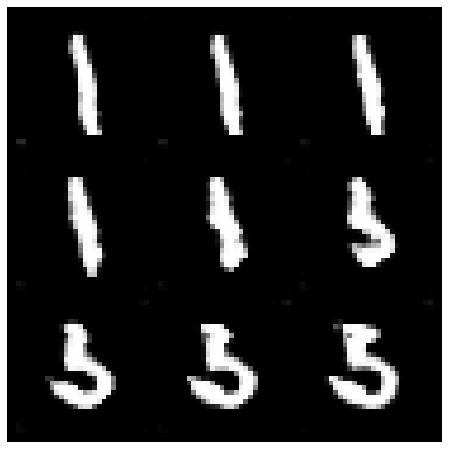

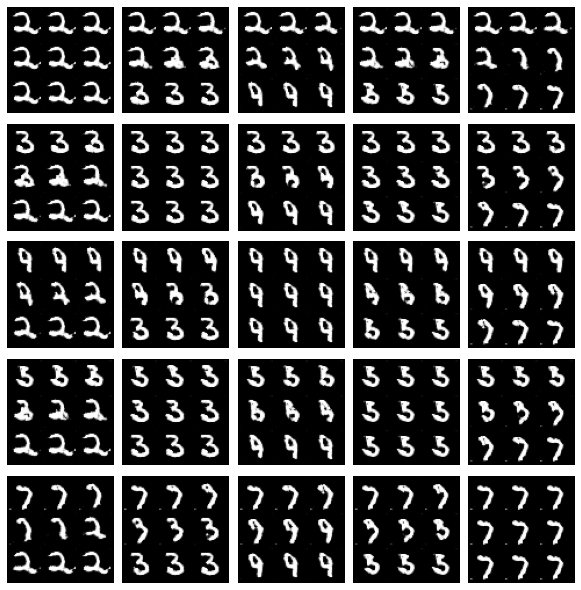

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Following lines of code visualize a set of pairwise class interpolations
### for a collection of different numbers, all in a single grid of interpolations.
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

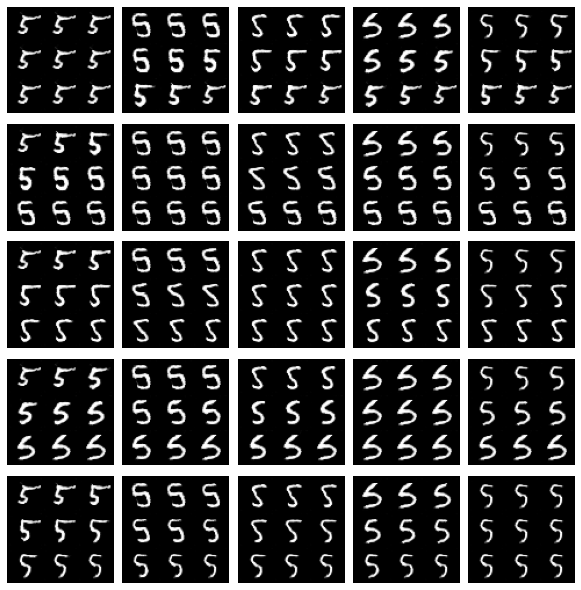

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()